In [ ]:
%matplotlib inline

# install pillow
!pip install Pillow -U

# # download and unzip dataset o train
# !wget http://images.cocodataset.org/zips/val2014.zip
# !mkdir train
# %cd /content/train
# !unzip -qq /content/val2014.zip
# %cd ..

#download model
!wget https://web.eecs.umich.edu/~justincj/models/vgg16-00b39a1b.pth

     |████████████████████████████████| 4.3 MB 14.4 MB/s 
  Attempting uninstall: Pillow
    Found existing installation: Pillow 7.1.2
    Uninstalling Pillow-7.1.2:
      Successfully uninstalled Pillow-7.1.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


--2022-05-07 22:29:29--  https://web.eecs.umich.edu/~justincj/models/vgg16-00b39a1b.pth
Resolving web.eecs.umich.edu (web.eecs.umich.edu)... 141.212.113.214
Connecting to web.eecs.umich.edu (web.eecs.umich.edu)|141.212.113.214|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 553451520 (528M) [application/x-tar]
Saving to: ‘vgg16-00b39a1b.pth’

vgg16-00b39a1b.pth  100%[===================>] 527.81M  26.8MB/s    in 20s     

2022-05-07 22:29:50 (25.9 MB/s) - ‘vgg16-00b39a1b.pth’ saved [553451520/553451520]



# Style Transfer Training

## Import Library

In [ ]:
import torch
import torch.nn as nn
import PIL
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
%matplotlib inline

# get utils functions
# from utils import grammatrix, loss_of_style, loss_of_content, content_transform, detransform_content, rescale

from PIL import Image
import cv2
import torch.optim as optim
from torchvision import datasets, transforms, models
import random
import numpy as np
import time
import vgg16_fe as vgg # this is used to extract features
import custom_model
import utils
# import vgg16 as vgg_style


In [ ]:
!sh download_data.sh

Streaming output truncated to the last 5000 lines.
  inflating: tiny-imagenet-200/val/images/val_3979.JPEG  
  inflating: tiny-imagenet-200/val/images/val_3963.JPEG  
  inflating: tiny-imagenet-200/val/images/val_7199.JPEG  
  inflating: tiny-imagenet-200/val/images/val_2752.JPEG  
  inflating: tiny-imagenet-200/val/images/val_9687.JPEG  
  inflating: tiny-imagenet-200/val/images/val_9407.JPEG  
  inflating: tiny-imagenet-200/val/images/val_3603.JPEG  
  inflating: tiny-imagenet-200/val/images/val_3412.JPEG  
  inflating: tiny-imagenet-200/val/images/val_6982.JPEG  
  inflating: tiny-imagenet-200/val/images/val_8496.JPEG  
  inflating: tiny-imagenet-200/val/images/val_7332.JPEG  
  inflating: tiny-imagenet-200/val/images/val_9241.JPEG  
  inflating: tiny-imagenet-200/val/images/val_4196.JPEG  
  inflating: tiny-imagenet-200/val/images/val_5980.JPEG  
  inflating: tiny-imagenet-200/val/images/val_6697.JPEG  
  inflating: tiny-imagenet-200/val/images/val_9969.JPEG  
  inflating: tiny-ima

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


# Trained on TinyImageNet dataset for different styles

## Udnie

In [ ]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = 'tiny-224/train'
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/udnie.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "udnie/models/"
SAVE_IMAGE_PATH = "udnie/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

In [ ]:
def train():
    # seeds
    torch.manual_seed(SEED)
    torch.cuda.manual_seed(SEED)
    np.random.seed(SEED)
    random.seed(SEED)

    # get the device
    device = ("cuda" if torch.cuda.is_available() else "cpu")

    # load the training dataset
    transform = transforms.Compose([
        transforms.Resize(TRAIN_IMAGE_SIZE),
        transforms.CenterCrop(TRAIN_IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x.mul(255))
    ])

    train_dataset = datasets.ImageFolder(DATASET_PATH, transform=transform)
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

    # load the models and start training :)
    model = custom_model.CustomModel().to(device)
    vgg16_fe = vgg.VGG16('/content/vgg16-00b39a1b.pth').to(device)

    # get style features
    imagenet_neg_mean = torch.tensor([-103.939, -116.779, -123.68], dtype=torch.float32).reshape(1,3,1,1).to(device)
    # load the style image
    style_image = utils.load_image(STYLE_IMAGE_PATH)
    # convert style image to tensor
    style_tensor = utils.itot(style_image).to(device)
    # add imagenet mean
    style_tensor = style_tensor.add(imagenet_neg_mean)

    B, C, H, W = style_tensor.shape
    # get the features of the style image
    style_features = vgg16_fe(style_tensor.expand([BATCH_SIZE, C, H, W]))

    # get the gram matrix of the style image
    style_gram = {}
    for key, value in style_features.items():
        style_gram[key] = utils.gram(value)

    # Optimizer settings
    optimizer = optim.Adam(model.parameters(), lr=ADAM_LR)

    # Loss trackers
    content_loss_history = []
    style_loss_history = []
    total_loss_history = []
    batch_content_loss_sum = 0
    batch_style_loss_sum = 0
    batch_total_loss_sum = 0

    # Optimization/Training Loop
    batch_count = 1
    start_time = time.time()

    # training loop
    for epoch in range(NUM_EPOCHS):
        print("========Epoch {}/{}========".format(epoch+1, NUM_EPOCHS))
        for content_batch, _ in train_loader:
            # Get current batch size in case of odd batch sizes
            curr_batch_size = content_batch.shape[0]

            # free up unnecessary memory of cuda
            torch.cuda.empty_cache()

            # zero the gradients
            optimizer.zero_grad()

            # Generate images and get features
            content_batch = content_batch[:,[2,1,0]].to(device)
            generated_batch = model(content_batch)
            content_features = vgg16_fe(content_batch.add(imagenet_neg_mean))
            generated_features = vgg16_fe(generated_batch.add(imagenet_neg_mean))

            # Calculate content loss
            MSELoss = nn.MSELoss().to(device)
            content_loss = CONTENT_WEIGHT * MSELoss(generated_features['relu1_2'], content_features['relu1_2'])            
            batch_content_loss_sum += content_loss

            # Calculate style loss
            style_loss = 0
            for key, value in generated_features.items():
                s_loss = MSELoss(utils.gram(value), style_gram[key][:curr_batch_size])
                style_loss += s_loss
            style_loss *= STYLE_WEIGHT
            batch_style_loss_sum += style_loss.item()

            # Calculate total loss
            total_loss = content_loss + style_loss
            batch_total_loss_sum += total_loss.item()

            # Backpropagation
            total_loss.backward()
            optimizer.step()

            # Save Model and Print Losses
            if (((batch_count-1)%SAVE_MODEL_EVERY == 0) or (batch_count==NUM_EPOCHS*len(train_loader))):
                # Print Losses
                print("========Iteration {}/{}========".format(batch_count, NUM_EPOCHS*len(train_loader)))
                print("\tContent Loss:\t{:.2f}".format(batch_content_loss_sum/batch_count))
                print("\tStyle Loss:\t{:.2f}".format(batch_style_loss_sum/batch_count))
                print("\tTotal Loss:\t{:.2f}".format(batch_total_loss_sum/batch_count))
                print("Time elapsed:\t{} seconds".format(time.time()-start_time))

                # Save Model
                checkpoint_path = SAVE_MODEL_PATH + "checkpoint_" + str(batch_count-1) + ".pth"
                torch.save(model.state_dict(), checkpoint_path)
                
                print("Saved CustomModel checkpoint file at {}".format(checkpoint_path))

                # Save sample generated image
                sample_tensor = generated_batch[0].clone().detach().unsqueeze(dim=0) # clone to save inplace errors
                sample_image = utils.ttoi(sample_tensor.clone().detach())
                sample_image_path = SAVE_IMAGE_PATH + "sample0_" + str(batch_count-1) + ".png"
                utils.saveimg(sample_image, sample_image_path)
                utils.show(sample_image)
                print("Saved sample stylized image at {}".format(sample_image_path))

                # Save loss histories
                content_loss_history.append(batch_total_loss_sum/batch_count)
                style_loss_history.append(batch_style_loss_sum/batch_count)
                total_loss_history.append(batch_total_loss_sum/batch_count)
            
            # increment batch count
            batch_count += 1
    
    stop_time = time.time()
    # Print loss histories
    print("Done Training the Network!")
    print("Training Time: {} seconds".format(stop_time-start_time))
    print("========Content Loss========")
    print(content_loss_history) 
    print("========Style Loss========")
    print(style_loss_history) 
    print("========Total Loss========")
    print(total_loss_history) 

    # Save TransformerNetwork weights
    model.eval()
    model.cpu()
    final_path = SAVE_MODEL_PATH + "transformer_weight.pth"
    print("Saving Custom Model weights at {}".format(final_path))
    torch.save(model.state_dict(), final_path)
    print("Done saving final model")

    # Plot Loss Histories
    if (PLOT_LOSS):
        utils.plot_loss_hist(content_loss_history, style_loss_history, total_loss_history)


========Epoch 1/1========
========Iteration 1/25000========
	Content Loss:	792234.38
	Style Loss:	20193196.00
	Total Loss:	20985430.00
Time elapsed:	0.32027196884155273 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_0.pth


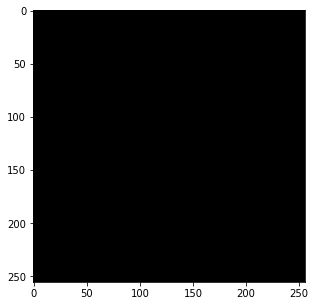

Saved sample stylized image at udnie/images/sample0_0.png
========Iteration 501/25000========
	Content Loss:	567148.44
	Style Loss:	2643820.18
	Total Loss:	3210968.59
Time elapsed:	46.13458752632141 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_500.pth


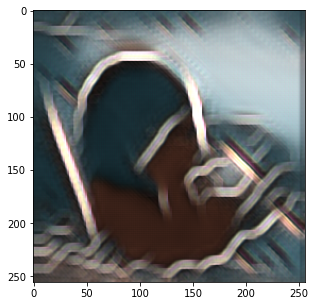

Saved sample stylized image at udnie/images/sample0_500.png
========Iteration 1001/25000========
	Content Loss:	527752.50
	Style Loss:	1583183.17
	Total Loss:	2110935.90
Time elapsed:	91.15572738647461 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_1000.pth


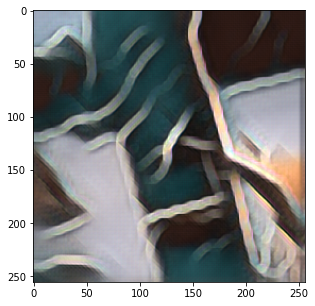

Saved sample stylized image at udnie/images/sample0_1000.png
========Iteration 1501/25000========
	Content Loss:	508721.81
	Style Loss:	1170440.15
	Total Loss:	1679162.21
Time elapsed:	136.1380181312561 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_1500.pth


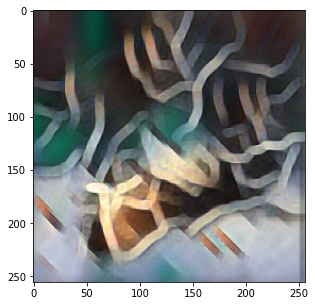

Saved sample stylized image at udnie/images/sample0_1500.png
========Iteration 2001/25000========
	Content Loss:	493844.66
	Style Loss:	948279.97
	Total Loss:	1442124.79
Time elapsed:	181.60529446601868 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_2000.pth


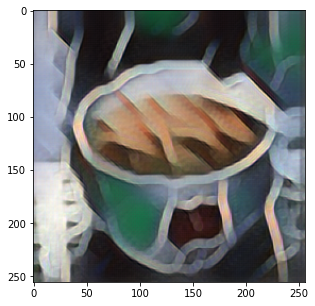

Saved sample stylized image at udnie/images/sample0_2000.png
========Iteration 2501/25000========
	Content Loss:	480297.56
	Style Loss:	807802.38
	Total Loss:	1288099.95
Time elapsed:	227.35839819908142 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_2500.pth


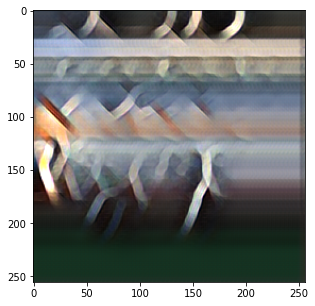

Saved sample stylized image at udnie/images/sample0_2500.png
========Iteration 3001/25000========
	Content Loss:	470493.12
	Style Loss:	710575.39
	Total Loss:	1181068.57
Time elapsed:	273.07101559638977 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_3000.pth


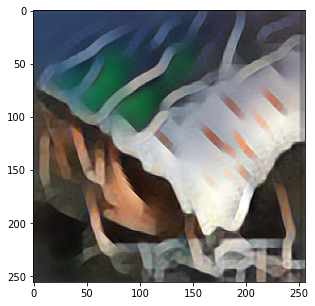

Saved sample stylized image at udnie/images/sample0_3000.png
========Iteration 3501/25000========
	Content Loss:	463304.66
	Style Loss:	638696.15
	Total Loss:	1102000.44
Time elapsed:	318.78123927116394 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_3500.pth


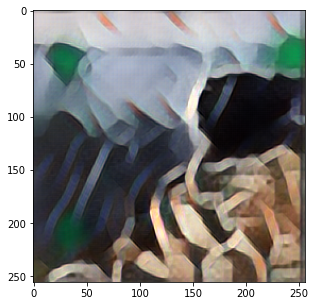

Saved sample stylized image at udnie/images/sample0_3500.png
========Iteration 4001/25000========
	Content Loss:	457683.59
	Style Loss:	583064.41
	Total Loss:	1040748.14
Time elapsed:	364.3791377544403 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_4000.pth


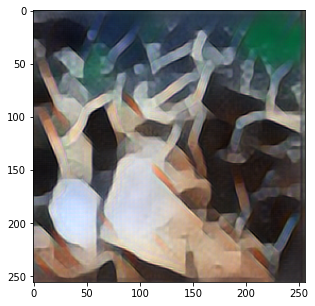

Saved sample stylized image at udnie/images/sample0_4000.png
========Iteration 4501/25000========
	Content Loss:	454358.16
	Style Loss:	538932.93
	Total Loss:	993291.07
Time elapsed:	409.74732971191406 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_4500.pth


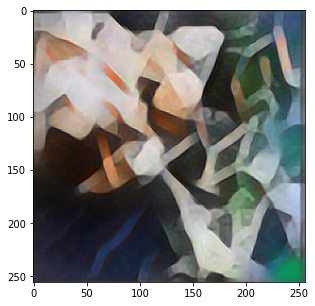

Saved sample stylized image at udnie/images/sample0_4500.png
========Iteration 5001/25000========
	Content Loss:	448509.91
	Style Loss:	502378.07
	Total Loss:	950887.79
Time elapsed:	454.88371086120605 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_5000.pth


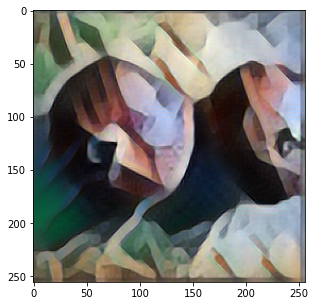

Saved sample stylized image at udnie/images/sample0_5000.png
========Iteration 5501/25000========
	Content Loss:	443982.19
	Style Loss:	471617.12
	Total Loss:	915598.97
Time elapsed:	500.19825053215027 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_5500.pth


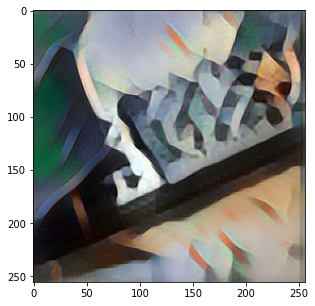

Saved sample stylized image at udnie/images/sample0_5500.png
========Iteration 6001/25000========
	Content Loss:	439340.50
	Style Loss:	445509.87
	Total Loss:	884849.77
Time elapsed:	545.193895816803 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_6000.pth


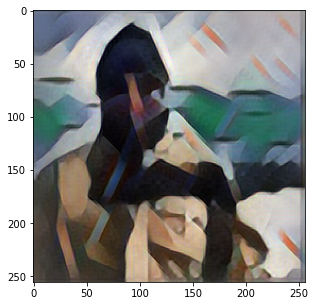

Saved sample stylized image at udnie/images/sample0_6000.png
========Iteration 6501/25000========
	Content Loss:	435733.69
	Style Loss:	423101.95
	Total Loss:	858835.43
Time elapsed:	590.7085871696472 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_6500.pth


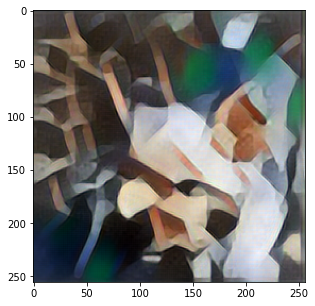

Saved sample stylized image at udnie/images/sample0_6500.png
========Iteration 7001/25000========
	Content Loss:	432523.50
	Style Loss:	403698.37
	Total Loss:	836222.02
Time elapsed:	636.1596639156342 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_7000.pth


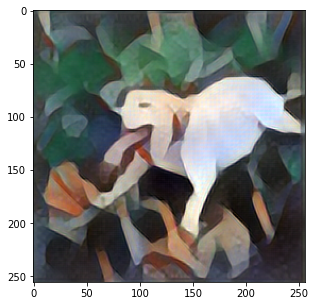

Saved sample stylized image at udnie/images/sample0_7000.png
========Iteration 7501/25000========
	Content Loss:	430074.00
	Style Loss:	386609.13
	Total Loss:	816683.20
Time elapsed:	681.7226159572601 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_7500.pth


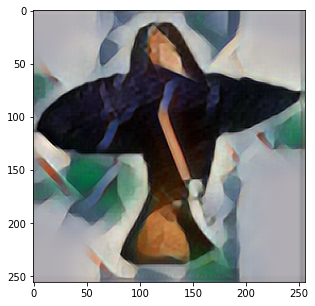

Saved sample stylized image at udnie/images/sample0_7500.png
========Iteration 8001/25000========
	Content Loss:	427805.97
	Style Loss:	371403.01
	Total Loss:	799208.54
Time elapsed:	726.9932608604431 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_8000.pth


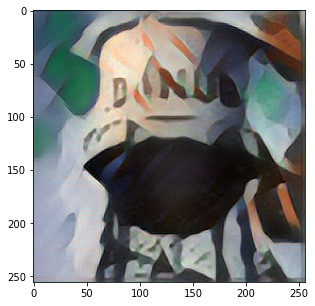

Saved sample stylized image at udnie/images/sample0_8000.png
========Iteration 8501/25000========
	Content Loss:	425304.69
	Style Loss:	357910.43
	Total Loss:	783214.55
Time elapsed:	772.5796999931335 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_8500.pth


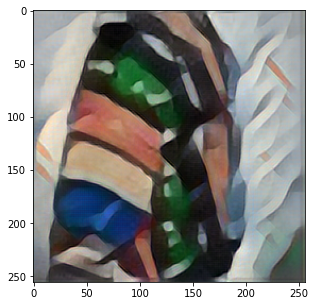

Saved sample stylized image at udnie/images/sample0_8500.png
========Iteration 9001/25000========
	Content Loss:	422303.69
	Style Loss:	345667.68
	Total Loss:	767970.65
Time elapsed:	817.9369325637817 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_9000.pth


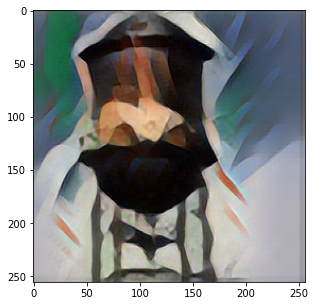

Saved sample stylized image at udnie/images/sample0_9000.png
========Iteration 9501/25000========
	Content Loss:	420018.75
	Style Loss:	334670.48
	Total Loss:	754688.37
Time elapsed:	863.433443069458 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_9500.pth


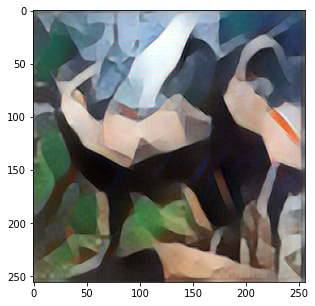

Saved sample stylized image at udnie/images/sample0_9500.png
========Iteration 10001/25000========
	Content Loss:	417941.34
	Style Loss:	324697.10
	Total Loss:	742637.49
Time elapsed:	908.6159868240356 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_10000.pth


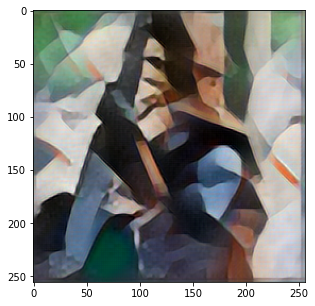

Saved sample stylized image at udnie/images/sample0_10000.png
========Iteration 10501/25000========
	Content Loss:	415850.06
	Style Loss:	315585.33
	Total Loss:	731434.80
Time elapsed:	953.7822089195251 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_10500.pth


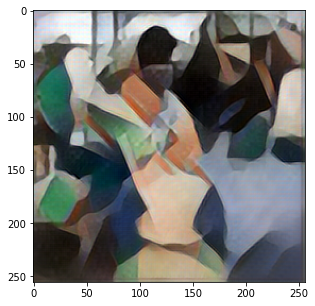

Saved sample stylized image at udnie/images/sample0_10500.png
========Iteration 11001/25000========
	Content Loss:	413908.47
	Style Loss:	307260.81
	Total Loss:	721168.15
Time elapsed:	998.6987404823303 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_11000.pth


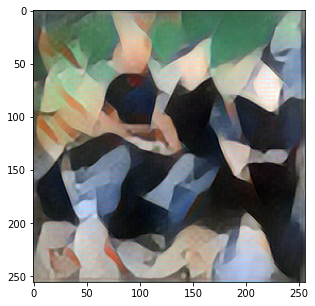

Saved sample stylized image at udnie/images/sample0_11000.png
========Iteration 11501/25000========
	Content Loss:	412294.97
	Style Loss:	299577.52
	Total Loss:	711871.54
Time elapsed:	1043.8214156627655 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_11500.pth


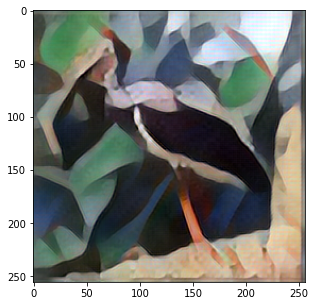

Saved sample stylized image at udnie/images/sample0_11500.png
========Iteration 12001/25000========
	Content Loss:	410231.81
	Style Loss:	292534.05
	Total Loss:	702765.02
Time elapsed:	1088.7150435447693 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_12000.pth


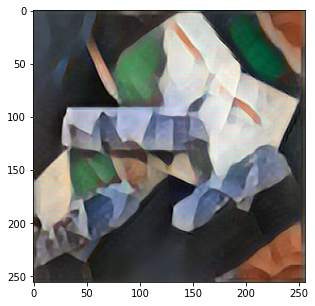

Saved sample stylized image at udnie/images/sample0_12000.png
========Iteration 12501/25000========
	Content Loss:	408745.03
	Style Loss:	285991.99
	Total Loss:	694736.26
Time elapsed:	1133.6218855381012 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_12500.pth


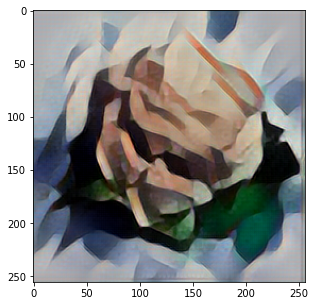

Saved sample stylized image at udnie/images/sample0_12500.png
========Iteration 13001/25000========
	Content Loss:	407666.56
	Style Loss:	279923.59
	Total Loss:	687589.19
Time elapsed:	1178.5440378189087 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_13000.pth


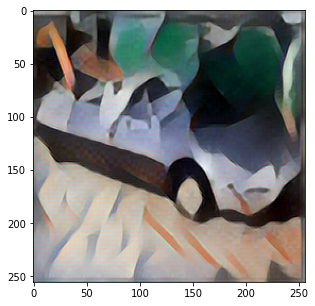

Saved sample stylized image at udnie/images/sample0_13000.png
========Iteration 13501/25000========
	Content Loss:	406112.59
	Style Loss:	274222.54
	Total Loss:	680334.06
Time elapsed:	1223.6771743297577 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_13500.pth


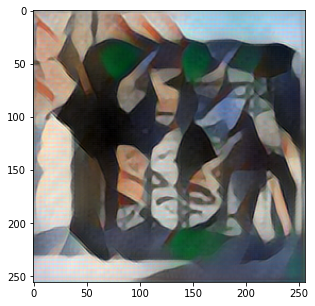

Saved sample stylized image at udnie/images/sample0_13500.png
========Iteration 14001/25000========
	Content Loss:	404873.16
	Style Loss:	268824.01
	Total Loss:	673696.07
Time elapsed:	1268.581295967102 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_14000.pth


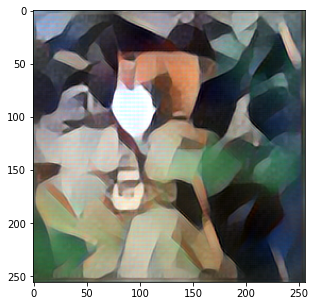

Saved sample stylized image at udnie/images/sample0_14000.png
========Iteration 14501/25000========
	Content Loss:	403511.06
	Style Loss:	263806.35
	Total Loss:	667316.10
Time elapsed:	1313.6778643131256 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_14500.pth


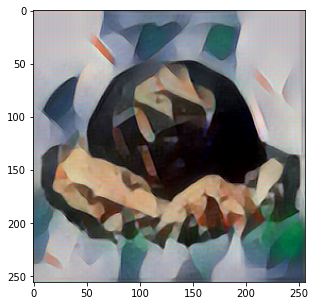

Saved sample stylized image at udnie/images/sample0_14500.png
========Iteration 15001/25000========
	Content Loss:	402155.22
	Style Loss:	259134.50
	Total Loss:	661288.30
Time elapsed:	1358.66029047966 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_15000.pth


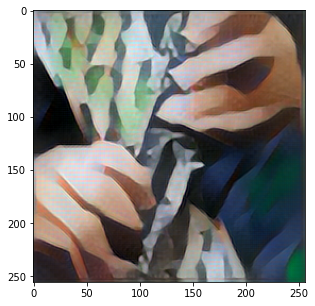

Saved sample stylized image at udnie/images/sample0_15000.png
========Iteration 15501/25000========
	Content Loss:	400881.16
	Style Loss:	254674.91
	Total Loss:	655554.81
Time elapsed:	1403.6344912052155 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_15500.pth


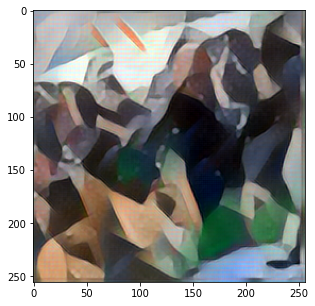

Saved sample stylized image at udnie/images/sample0_15500.png
========Iteration 16001/25000========
	Content Loss:	399798.44
	Style Loss:	250450.11
	Total Loss:	650247.14
Time elapsed:	1448.48992061615 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_16000.pth


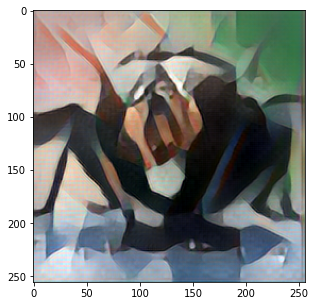

Saved sample stylized image at udnie/images/sample0_16000.png
========Iteration 16501/25000========
	Content Loss:	398732.12
	Style Loss:	246487.66
	Total Loss:	645218.51
Time elapsed:	1493.5545506477356 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_16500.pth


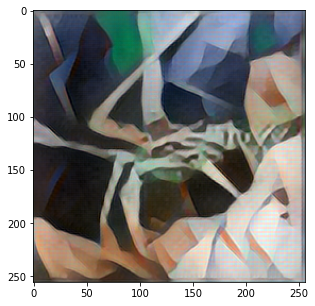

Saved sample stylized image at udnie/images/sample0_16500.png
========Iteration 17001/25000========
	Content Loss:	397871.31
	Style Loss:	242746.26
	Total Loss:	640616.41
Time elapsed:	1538.405741930008 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_17000.pth


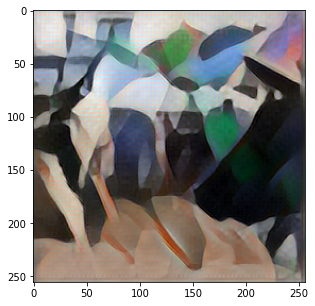

Saved sample stylized image at udnie/images/sample0_17000.png
========Iteration 17501/25000========
	Content Loss:	396652.00
	Style Loss:	239169.19
	Total Loss:	635820.26
Time elapsed:	1583.409879207611 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_17500.pth


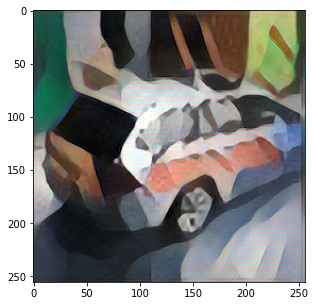

Saved sample stylized image at udnie/images/sample0_17500.png
========Iteration 18001/25000========
	Content Loss:	395860.62
	Style Loss:	235849.51
	Total Loss:	631709.35
Time elapsed:	1628.1018648147583 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_18000.pth


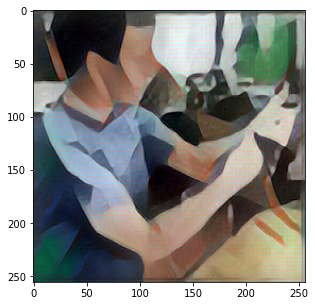

Saved sample stylized image at udnie/images/sample0_18000.png
========Iteration 18501/25000========
	Content Loss:	394704.75
	Style Loss:	232612.47
	Total Loss:	627316.19
Time elapsed:	1672.90083360672 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_18500.pth


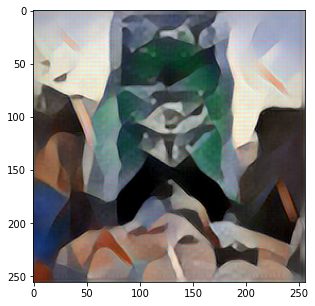

Saved sample stylized image at udnie/images/sample0_18500.png
========Iteration 19001/25000========
	Content Loss:	394069.06
	Style Loss:	229555.71
	Total Loss:	623623.43
Time elapsed:	1717.5706527233124 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_19000.pth


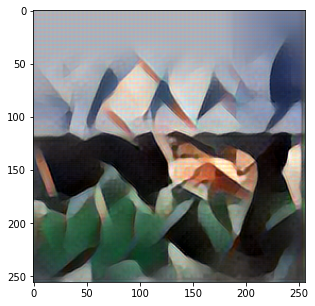

Saved sample stylized image at udnie/images/sample0_19000.png
========Iteration 19501/25000========
	Content Loss:	392943.62
	Style Loss:	226615.30
	Total Loss:	619557.71
Time elapsed:	1762.654364824295 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_19500.pth


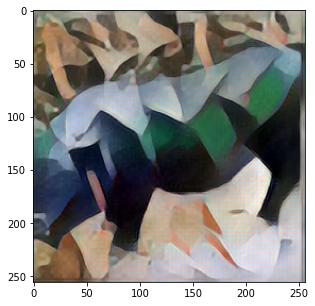

Saved sample stylized image at udnie/images/sample0_19500.png
========Iteration 20001/25000========
	Content Loss:	392107.09
	Style Loss:	223806.39
	Total Loss:	615912.24
Time elapsed:	1807.6910319328308 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_20000.pth


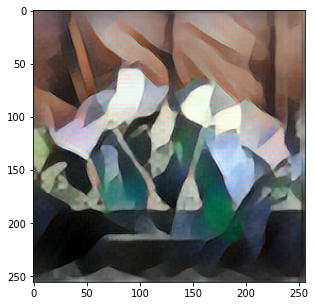

Saved sample stylized image at udnie/images/sample0_20000.png
========Iteration 20501/25000========
	Content Loss:	391336.03
	Style Loss:	221142.08
	Total Loss:	612476.96
Time elapsed:	1852.9291512966156 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_20500.pth


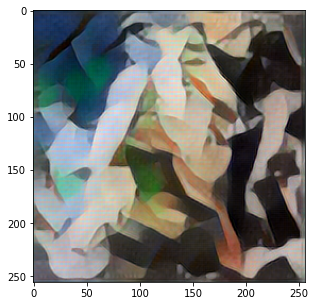

Saved sample stylized image at udnie/images/sample0_20500.png
========Iteration 21001/25000========
	Content Loss:	390760.34
	Style Loss:	218562.44
	Total Loss:	609321.69
Time elapsed:	1898.0200390815735 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_21000.pth


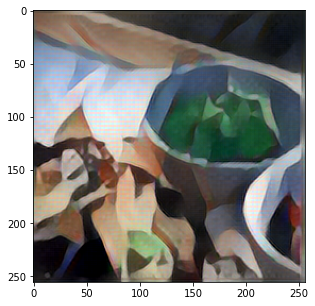

Saved sample stylized image at udnie/images/sample0_21000.png
========Iteration 21501/25000========
	Content Loss:	390163.94
	Style Loss:	216108.20
	Total Loss:	606271.01
Time elapsed:	1943.339094877243 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_21500.pth


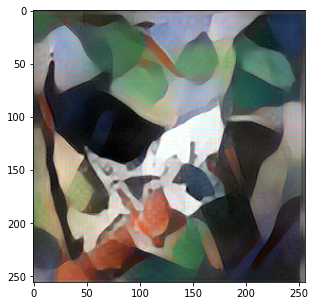

Saved sample stylized image at udnie/images/sample0_21500.png
========Iteration 22001/25000========
	Content Loss:	389269.59
	Style Loss:	213774.33
	Total Loss:	603042.67
Time elapsed:	1988.21994638443 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_22000.pth


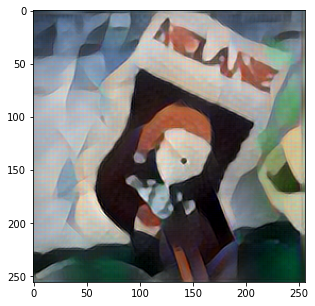

Saved sample stylized image at udnie/images/sample0_22000.png
========Iteration 22501/25000========
	Content Loss:	388434.72
	Style Loss:	211507.44
	Total Loss:	599941.18
Time elapsed:	2033.2597119808197 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_22500.pth


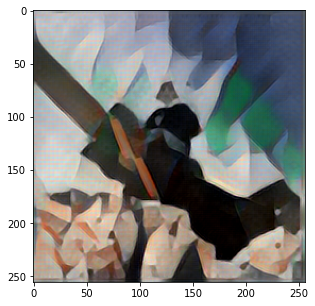

Saved sample stylized image at udnie/images/sample0_22500.png
========Iteration 23001/25000========
	Content Loss:	387968.88
	Style Loss:	209351.58
	Total Loss:	597319.27
Time elapsed:	2078.030732154846 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_23000.pth


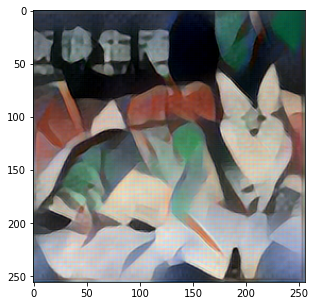

Saved sample stylized image at udnie/images/sample0_23000.png
========Iteration 23501/25000========
	Content Loss:	387058.53
	Style Loss:	207244.93
	Total Loss:	594301.95
Time elapsed:	2123.2028210163116 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_23500.pth


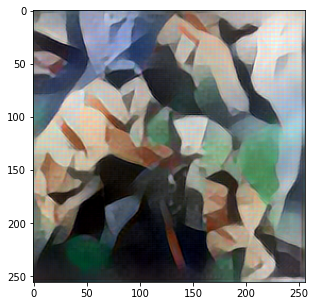

Saved sample stylized image at udnie/images/sample0_23500.png
========Iteration 24001/25000========
	Content Loss:	386242.97
	Style Loss:	205235.92
	Total Loss:	591477.29
Time elapsed:	2167.943473815918 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_24000.pth


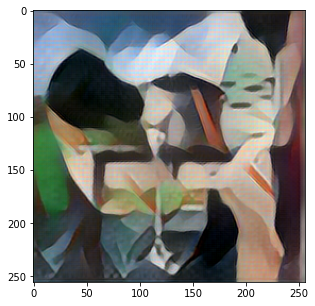

Saved sample stylized image at udnie/images/sample0_24000.png
========Iteration 24501/25000========
	Content Loss:	385841.69
	Style Loss:	203308.30
	Total Loss:	589148.38
Time elapsed:	2212.898511648178 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_24500.pth


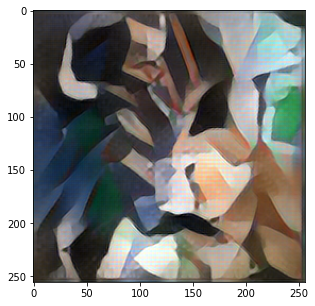

Saved sample stylized image at udnie/images/sample0_24500.png
========Iteration 25000/25000========
	Content Loss:	385240.31
	Style Loss:	201450.88
	Total Loss:	586690.07
Time elapsed:	2257.6095023155212 seconds
Saved CustomModel checkpoint file at udnie/models/checkpoint_24999.pth


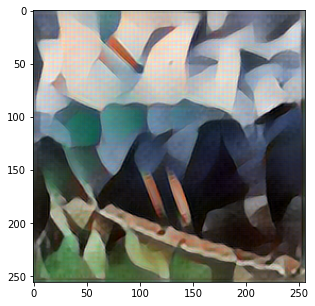

Saved sample stylized image at udnie/images/sample0_24999.png
Done Training the Network!
Training Time: 2257.822815656662 seconds
========Content Loss========
[20985430.0, 3210968.5875748503, 2110935.901411089, 1679162.2094437042, 1442124.7893553223, 1288099.9459216313, 1181068.5688208097, 1102000.4439624392, 1040748.140253999, 993291.0682417796, 950887.7937912417, 915598.965046128, 884849.7692832445, 858835.4303472543, 836222.0199658978, 816683.2048268564, 799208.5421470754, 783214.5517659687, 767970.6469871403, 754688.3741415377, 742637.489669783, 731434.7987066708, 721168.1535655849, 711871.5447080688, 702765.0238912383, 694736.2591692664, 687589.1920429198, 680334.0633355862, 673696.0738652596, 667316.1020123612, 661288.2970656123, 655554.8109033288, 650247.1418934754, 645218.5095657081, 640616.4063584495, 635820.2635027998, 631709.3512669435, 627316.1931669234, 623623.4346695569, 619557.7117327317, 615912.2371725164, 612476.9577993146, 609321.6855149755, 606271.0106739221, 603042.

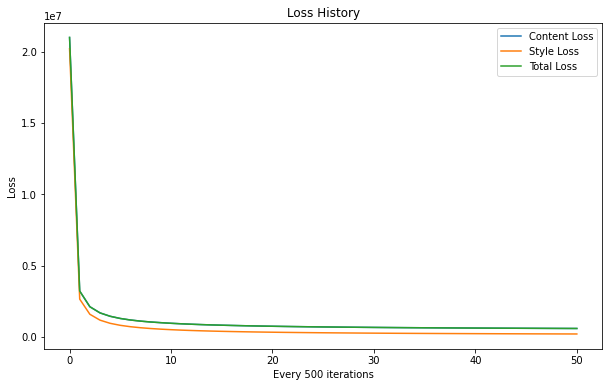

In [ ]:
train()

In [ ]:
# copy the models folder to the folder in the google drive
!cp -r udnie/models/ /content/gdrive/My\ Drive/tinyimagenet_custom/udnie/
# copy the images folder to the folder in the google drive
!cp -r udnie/images/ /content/gdrive/My\ Drive/tinyimagenet_custom/udnie/

## Rain Princess

In [ ]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = 'tiny-224/train'
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/rain_princess.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "rain_princess/models/"
SAVE_IMAGE_PATH = "rain_princess/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/25000========
	Content Loss:	792234.44
	Style Loss:	73494896.00
	Total Loss:	74287128.00
Time elapsed:	0.3736755847930908 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_0.pth


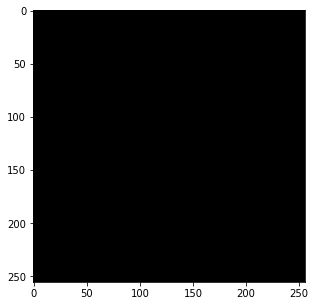

Saved sample stylized image at rain_princess/images/sample0_0.png
========Iteration 501/25000========
	Content Loss:	937840.62
	Style Loss:	13568910.26
	Total Loss:	14506751.10
Time elapsed:	34.953624963760376 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_500.pth


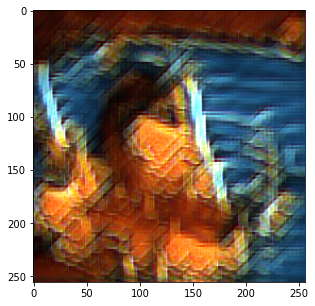

Saved sample stylized image at rain_princess/images/sample0_500.png
========Iteration 1001/25000========
	Content Loss:	984056.19
	Style Loss:	7609622.41
	Total Loss:	8593679.18
Time elapsed:	69.59709405899048 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_1000.pth


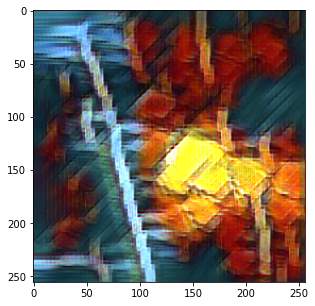

Saved sample stylized image at rain_princess/images/sample0_1000.png
========Iteration 1501/25000========
	Content Loss:	992427.94
	Style Loss:	5426985.58
	Total Loss:	6419414.59
Time elapsed:	104.21151900291443 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_1500.pth


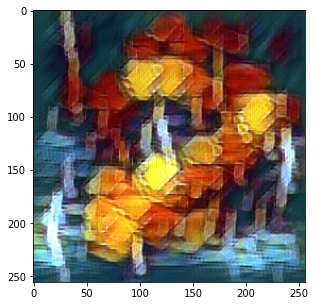

Saved sample stylized image at rain_princess/images/sample0_1500.png
========Iteration 2001/25000========
	Content Loss:	991383.00
	Style Loss:	4280728.41
	Total Loss:	5272112.02
Time elapsed:	138.8340790271759 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_2000.pth


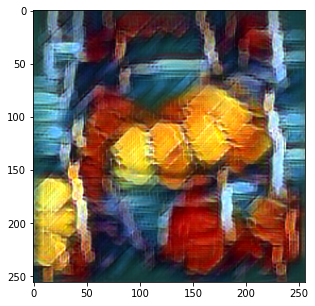

Saved sample stylized image at rain_princess/images/sample0_2000.png
========Iteration 2501/25000========
	Content Loss:	986306.19
	Style Loss:	3573125.75
	Total Loss:	4559432.12
Time elapsed:	173.46779322624207 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_2500.pth


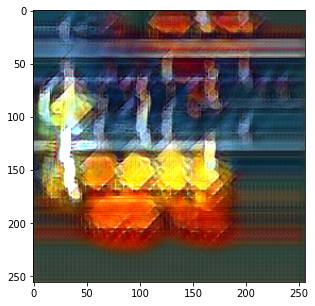

Saved sample stylized image at rain_princess/images/sample0_2500.png
========Iteration 3001/25000========
	Content Loss:	981474.69
	Style Loss:	3086558.14
	Total Loss:	4068032.28
Time elapsed:	208.1198627948761 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_3000.pth


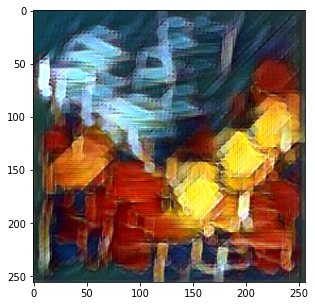

Saved sample stylized image at rain_princess/images/sample0_3000.png
========Iteration 3501/25000========
	Content Loss:	977428.69
	Style Loss:	2734292.22
	Total Loss:	3711720.17
Time elapsed:	242.79712581634521 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_3500.pth


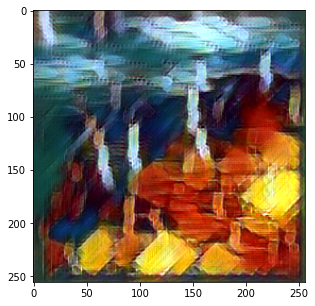

Saved sample stylized image at rain_princess/images/sample0_3500.png
========Iteration 4001/25000========
	Content Loss:	973051.44
	Style Loss:	2463046.19
	Total Loss:	3436096.21
Time elapsed:	277.478346824646 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_4000.pth


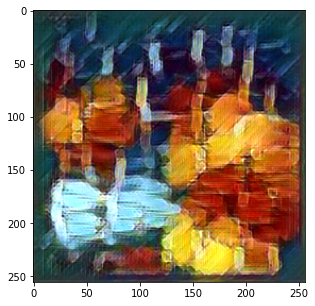

Saved sample stylized image at rain_princess/images/sample0_4000.png
========Iteration 4501/25000========
	Content Loss:	970198.38
	Style Loss:	2249747.04
	Total Loss:	3219944.15
Time elapsed:	312.20138812065125 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_4500.pth


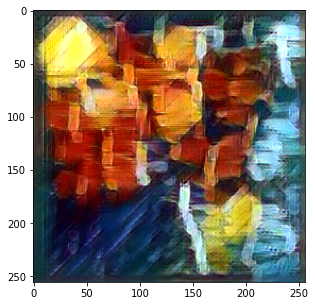

Saved sample stylized image at rain_princess/images/sample0_4500.png
========Iteration 5001/25000========
	Content Loss:	963866.06
	Style Loss:	2076466.26
	Total Loss:	3040331.17
Time elapsed:	346.88629388809204 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_5000.pth


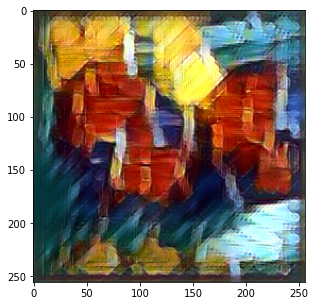

Saved sample stylized image at rain_princess/images/sample0_5000.png
========Iteration 5501/25000========
	Content Loss:	959424.06
	Style Loss:	1932471.80
	Total Loss:	2891894.27
Time elapsed:	381.68973660469055 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_5500.pth


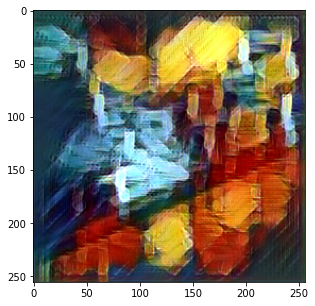

Saved sample stylized image at rain_princess/images/sample0_5500.png
========Iteration 6001/25000========
	Content Loss:	954283.31
	Style Loss:	1810684.44
	Total Loss:	2764965.69
Time elapsed:	416.3839313983917 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_6000.pth


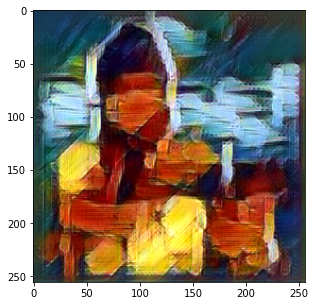

Saved sample stylized image at rain_princess/images/sample0_6000.png
========Iteration 6501/25000========
	Content Loss:	949925.81
	Style Loss:	1707285.76
	Total Loss:	2657209.75
Time elapsed:	450.9903562068939 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_6500.pth


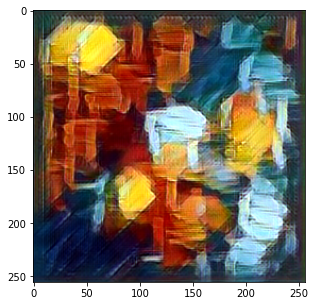

Saved sample stylized image at rain_princess/images/sample0_6500.png
========Iteration 7001/25000========
	Content Loss:	946002.38
	Style Loss:	1617379.77
	Total Loss:	2563380.09
Time elapsed:	485.5469491481781 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_7000.pth


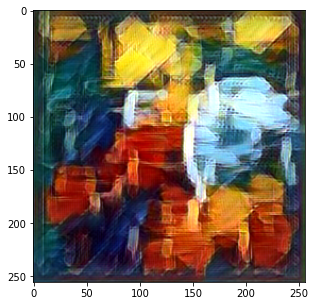

Saved sample stylized image at rain_princess/images/sample0_7000.png
========Iteration 7501/25000========
	Content Loss:	942660.69
	Style Loss:	1538897.59
	Total Loss:	2481555.85
Time elapsed:	520.123215675354 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_7500.pth


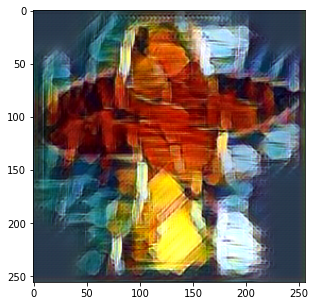

Saved sample stylized image at rain_princess/images/sample0_7500.png
========Iteration 8001/25000========
	Content Loss:	939639.25
	Style Loss:	1469406.05
	Total Loss:	2409043.16
Time elapsed:	554.6872179508209 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_8000.pth


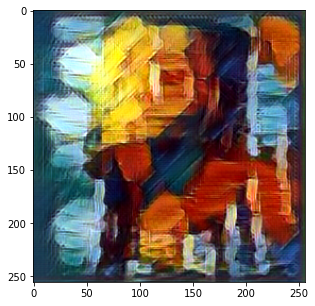

Saved sample stylized image at rain_princess/images/sample0_8000.png
========Iteration 8501/25000========
	Content Loss:	935978.62
	Style Loss:	1407794.34
	Total Loss:	2343771.36
Time elapsed:	589.2631001472473 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_8500.pth


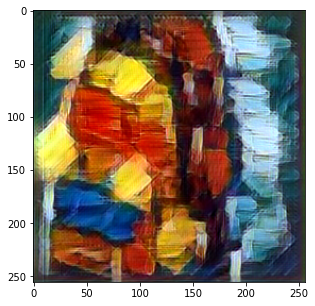

Saved sample stylized image at rain_princess/images/sample0_8500.png
========Iteration 9001/25000========
	Content Loss:	932222.56
	Style Loss:	1352255.44
	Total Loss:	2284476.76
Time elapsed:	623.9251532554626 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_9000.pth


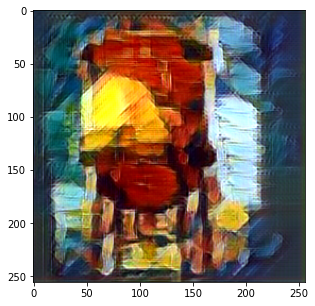

Saved sample stylized image at rain_princess/images/sample0_9000.png
========Iteration 9501/25000========
	Content Loss:	929090.06
	Style Loss:	1302341.83
	Total Loss:	2231430.99
Time elapsed:	658.5823223590851 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_9500.pth


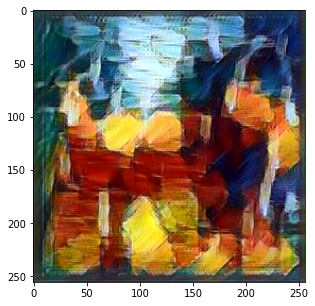

Saved sample stylized image at rain_princess/images/sample0_9500.png
========Iteration 10001/25000========
	Content Loss:	925676.31
	Style Loss:	1257012.26
	Total Loss:	2182688.67
Time elapsed:	693.2508592605591 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_10000.pth


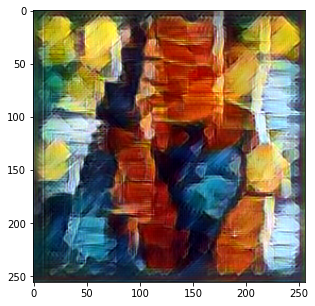

Saved sample stylized image at rain_princess/images/sample0_10000.png
========Iteration 10501/25000========
	Content Loss:	922500.38
	Style Loss:	1215453.44
	Total Loss:	2137954.13
Time elapsed:	727.9232401847839 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_10500.pth


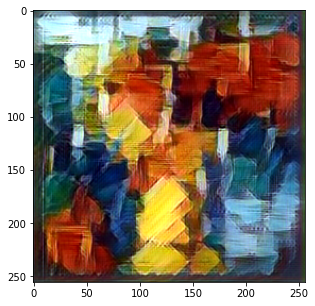

Saved sample stylized image at rain_princess/images/sample0_10500.png
========Iteration 11001/25000========
	Content Loss:	919811.19
	Style Loss:	1177634.94
	Total Loss:	2097447.56
Time elapsed:	762.5877435207367 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_11000.pth


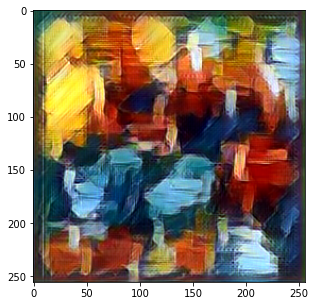

Saved sample stylized image at rain_princess/images/sample0_11000.png
========Iteration 11501/25000========
	Content Loss:	917348.25
	Style Loss:	1142652.66
	Total Loss:	2060001.53
Time elapsed:	797.2512679100037 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_11500.pth


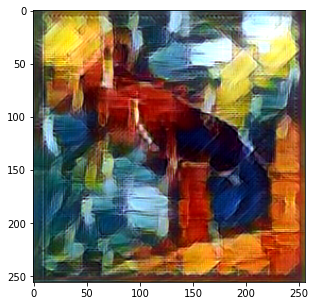

Saved sample stylized image at rain_princess/images/sample0_11500.png
========Iteration 12001/25000========
	Content Loss:	914591.81
	Style Loss:	1110847.99
	Total Loss:	2025439.72
Time elapsed:	831.9139151573181 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_12000.pth


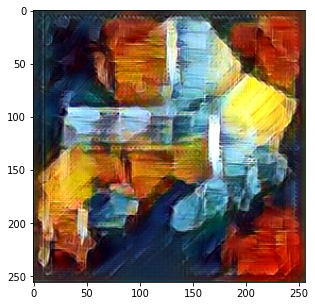

Saved sample stylized image at rain_princess/images/sample0_12000.png
========Iteration 12501/25000========
	Content Loss:	912255.69
	Style Loss:	1081260.42
	Total Loss:	1993515.68
Time elapsed:	866.5758922100067 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_12500.pth


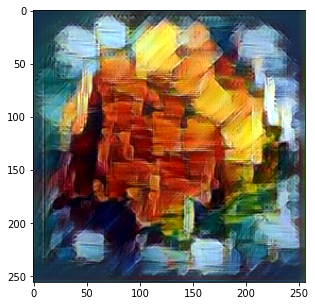

Saved sample stylized image at rain_princess/images/sample0_12500.png
========Iteration 13001/25000========
	Content Loss:	909984.94
	Style Loss:	1053896.63
	Total Loss:	1963880.66
Time elapsed:	901.263997554779 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_13000.pth


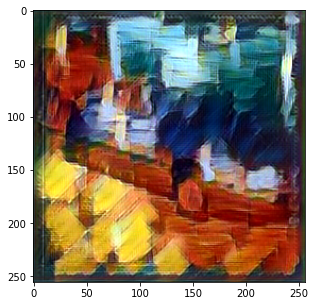

Saved sample stylized image at rain_princess/images/sample0_13000.png
========Iteration 13501/25000========
	Content Loss:	907510.25
	Style Loss:	1028162.20
	Total Loss:	1935671.07
Time elapsed:	935.8624329566956 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_13500.pth


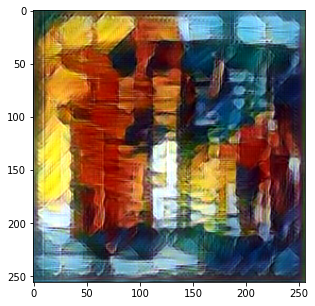

Saved sample stylized image at rain_princess/images/sample0_13500.png
========Iteration 14001/25000========
	Content Loss:	905483.25
	Style Loss:	1004078.19
	Total Loss:	1909559.72
Time elapsed:	970.4401621818542 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_14000.pth


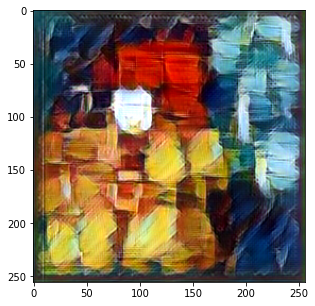

Saved sample stylized image at rain_princess/images/sample0_14000.png
========Iteration 14501/25000========
	Content Loss:	903158.88
	Style Loss:	981680.65
	Total Loss:	1884837.29
Time elapsed:	1005.0192623138428 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_14500.pth


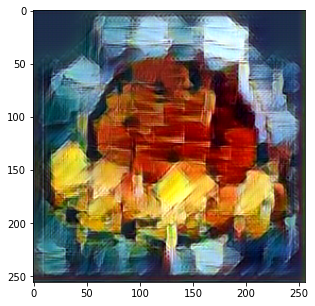

Saved sample stylized image at rain_princess/images/sample0_14500.png
========Iteration 15001/25000========
	Content Loss:	901029.62
	Style Loss:	960744.62
	Total Loss:	1861771.92
Time elapsed:	1039.698255777359 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_15000.pth


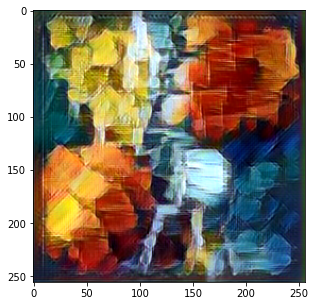

Saved sample stylized image at rain_princess/images/sample0_15000.png
========Iteration 15501/25000========
	Content Loss:	899005.81
	Style Loss:	940861.47
	Total Loss:	1839865.14
Time elapsed:	1074.2446484565735 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_15500.pth


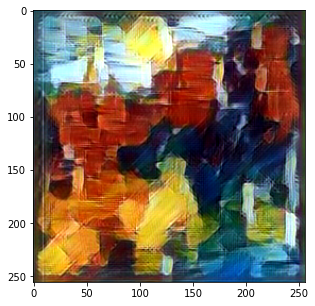

Saved sample stylized image at rain_princess/images/sample0_15500.png
========Iteration 16001/25000========
	Content Loss:	896914.44
	Style Loss:	922112.80
	Total Loss:	1819025.58
Time elapsed:	1108.798914194107 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_16000.pth


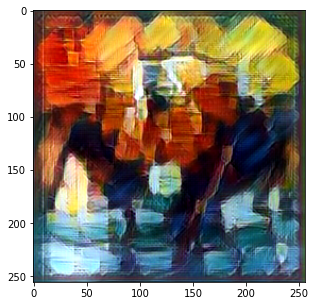

Saved sample stylized image at rain_princess/images/sample0_16000.png
========Iteration 16501/25000========
	Content Loss:	895079.88
	Style Loss:	904348.27
	Total Loss:	1799426.48
Time elapsed:	1143.3750262260437 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_16500.pth


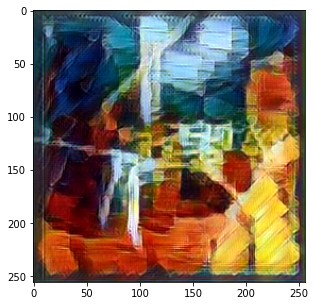

Saved sample stylized image at rain_princess/images/sample0_16500.png
========Iteration 17001/25000========
	Content Loss:	893400.44
	Style Loss:	887636.78
	Total Loss:	1781035.70
Time elapsed:	1177.9250783920288 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_17000.pth


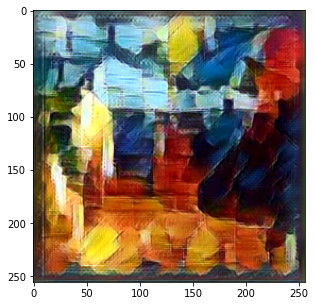

Saved sample stylized image at rain_princess/images/sample0_17000.png
========Iteration 17501/25000========
	Content Loss:	891360.38
	Style Loss:	871844.17
	Total Loss:	1763203.21
Time elapsed:	1212.5137133598328 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_17500.pth


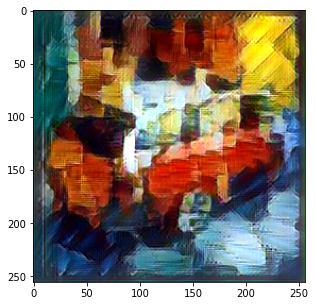

Saved sample stylized image at rain_princess/images/sample0_17500.png
========Iteration 18001/25000========
	Content Loss:	889940.25
	Style Loss:	857242.30
	Total Loss:	1747181.36
Time elapsed:	1247.1133685112 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_18000.pth


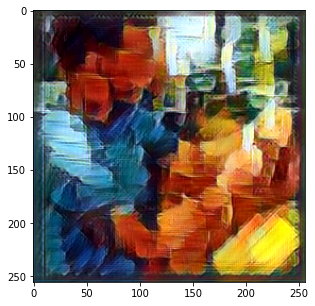

Saved sample stylized image at rain_princess/images/sample0_18000.png
========Iteration 18501/25000========
	Content Loss:	888282.88
	Style Loss:	843076.63
	Total Loss:	1731358.68
Time elapsed:	1281.7358405590057 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_18500.pth


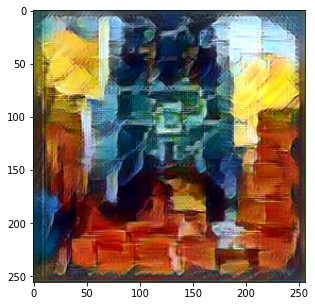

Saved sample stylized image at rain_princess/images/sample0_18500.png
========Iteration 19001/25000========
	Content Loss:	886871.50
	Style Loss:	829453.06
	Total Loss:	1716323.76
Time elapsed:	1316.3421518802643 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_19000.pth


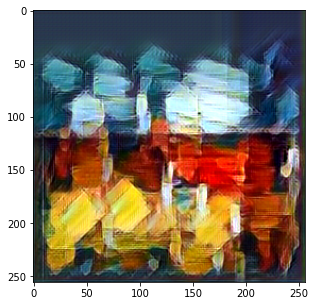

Saved sample stylized image at rain_princess/images/sample0_19000.png
========Iteration 19501/25000========
	Content Loss:	885178.31
	Style Loss:	816471.39
	Total Loss:	1701649.39
Time elapsed:	1350.9711616039276 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_19500.pth


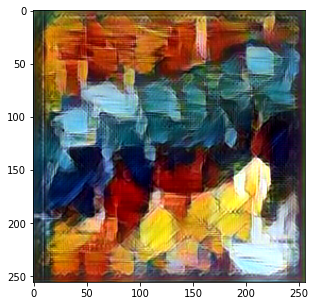

Saved sample stylized image at rain_princess/images/sample0_19500.png
========Iteration 20001/25000========
	Content Loss:	883574.75
	Style Loss:	804176.98
	Total Loss:	1687752.40
Time elapsed:	1385.609649181366 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_20000.pth


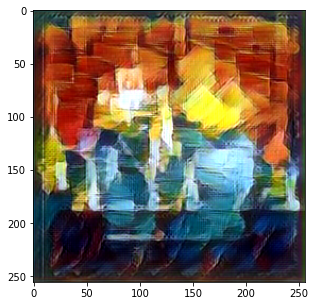

Saved sample stylized image at rain_princess/images/sample0_20000.png
========Iteration 20501/25000========
	Content Loss:	882343.81
	Style Loss:	792444.50
	Total Loss:	1674788.40
Time elapsed:	1420.2087607383728 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_20500.pth


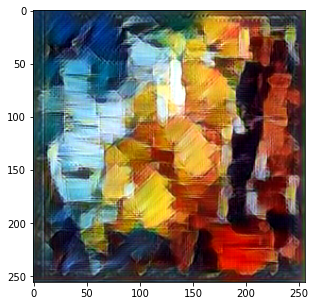

Saved sample stylized image at rain_princess/images/sample0_20500.png
========Iteration 21001/25000========
	Content Loss:	881101.06
	Style Loss:	781115.84
	Total Loss:	1662217.99
Time elapsed:	1454.8040895462036 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_21000.pth


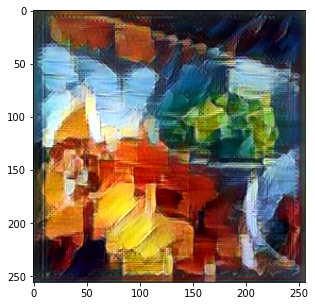

Saved sample stylized image at rain_princess/images/sample0_21000.png
========Iteration 21501/25000========
	Content Loss:	879815.50
	Style Loss:	770298.85
	Total Loss:	1650115.85
Time elapsed:	1489.4485654830933 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_21500.pth


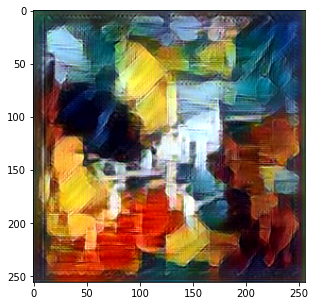

Saved sample stylized image at rain_princess/images/sample0_21500.png
========Iteration 22001/25000========
	Content Loss:	878341.12
	Style Loss:	760041.45
	Total Loss:	1638384.62
Time elapsed:	1524.09272646904 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_22000.pth


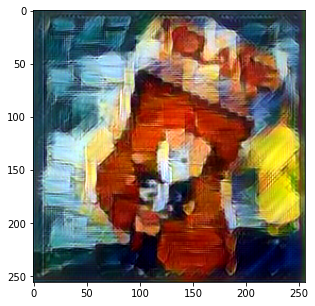

Saved sample stylized image at rain_princess/images/sample0_22000.png
========Iteration 22501/25000========
	Content Loss:	876976.00
	Style Loss:	750091.90
	Total Loss:	1627070.34
Time elapsed:	1558.7153317928314 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_22500.pth


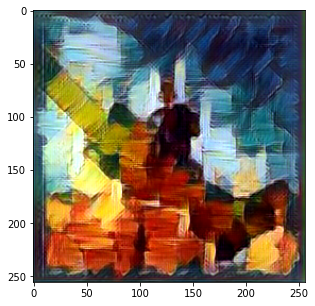

Saved sample stylized image at rain_princess/images/sample0_22500.png
========Iteration 23001/25000========
	Content Loss:	875778.62
	Style Loss:	740631.94
	Total Loss:	1616412.77
Time elapsed:	1593.3301455974579 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_23000.pth


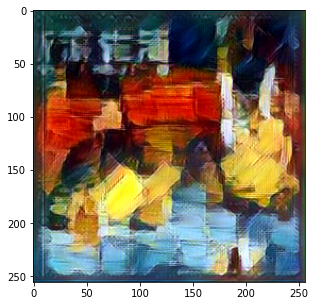

Saved sample stylized image at rain_princess/images/sample0_23000.png
========Iteration 23501/25000========
	Content Loss:	874285.94
	Style Loss:	731433.36
	Total Loss:	1605722.06
Time elapsed:	1627.8809943199158 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_23500.pth


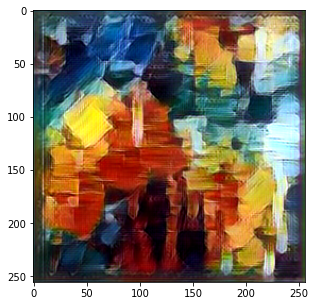

Saved sample stylized image at rain_princess/images/sample0_23500.png
========Iteration 24001/25000========
	Content Loss:	872837.56
	Style Loss:	722674.08
	Total Loss:	1595513.65
Time elapsed:	1662.4817559719086 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_24000.pth


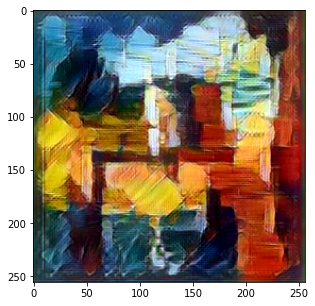

Saved sample stylized image at rain_princess/images/sample0_24000.png
========Iteration 24501/25000========
	Content Loss:	871877.56
	Style Loss:	714197.48
	Total Loss:	1586076.73
Time elapsed:	1697.2220730781555 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_24500.pth


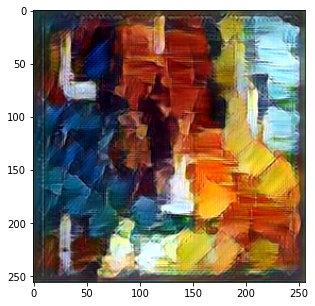

Saved sample stylized image at rain_princess/images/sample0_24500.png
========Iteration 25000/25000========
	Content Loss:	870601.56
	Style Loss:	706036.14
	Total Loss:	1576639.71
Time elapsed:	1731.8441178798676 seconds
Saved CustomModel checkpoint file at rain_princess/models/checkpoint_24999.pth


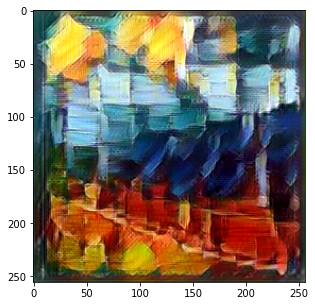

Saved sample stylized image at rain_princess/images/sample0_24999.png
Done Training the Network!
Training Time: 1732.06378865242 seconds
========Content Loss========
[74287128.0, 14506751.103792416, 8593679.176198801, 6419414.592771485, 5272112.024550225, 4559432.12240104, 4068032.277532489, 3711720.1684161667, 3436096.2050424893, 3219944.150688736, 3040331.1685412917, 2891894.2679512817, 2764965.6884894185, 2657209.7521919706, 2563380.0907013286, 2481555.847187042, 2409043.1628312087, 2343771.356980061, 2284476.755242473, 2231430.9891261444, 2182688.6695767925, 2137954.1272795447, 2097447.555534724, 2060001.5298724023, 2025439.723148071, 1993515.6781557475, 1963880.6592810168, 1935671.069041182, 1909559.7248544747, 1884837.2867431557, 1861771.9244675355, 1839865.136632314, 1819025.577764671, 1799426.4774672748, 1781035.6963083055, 1763203.2057739557, 1747181.3623409811, 1731358.6812402033, 1716323.7558615336, 1701649.3883358545, 1687752.399458152, 1674788.397197088, 1662217.9894290748

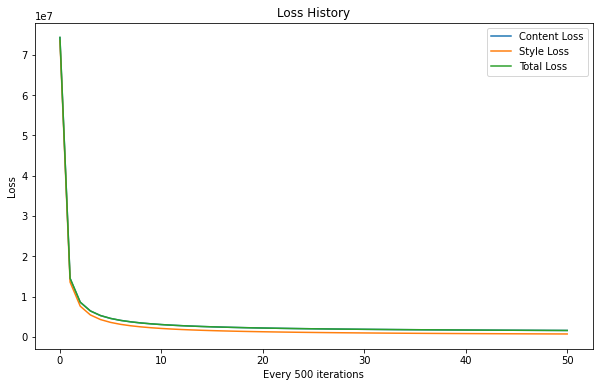

In [13]:
train()

In [14]:
# copy the models folder to the folder in the google drive
!cp -r rain_princess/models/ /content/gdrive/My\ Drive/tinyimagenet_custom/rain_princess/
# copy the images folder to the folder in the google drive
!cp -r rain_princess/images/ /content/gdrive/My\ Drive/tinyimagenet_custom/rain_princess/

## The Scream

In [15]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = 'tiny-224/train'
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/the_scream.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "the_scream/models/"
SAVE_IMAGE_PATH = "the_scream/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/25000========
	Content Loss:	792234.38
	Style Loss:	25249180.00
	Total Loss:	26041414.00
Time elapsed:	0.16655731201171875 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_0.pth


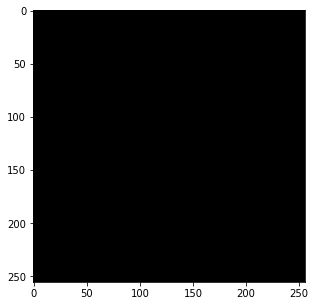

Saved sample stylized image at the_scream/images/sample0_0.png
========Iteration 501/25000========
	Content Loss:	635120.44
	Style Loss:	2291498.86
	Total Loss:	2926619.28
Time elapsed:	31.330934286117554 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_500.pth


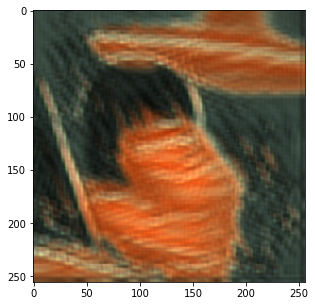

Saved sample stylized image at the_scream/images/sample0_500.png
========Iteration 1001/25000========
	Content Loss:	610847.94
	Style Loss:	1285552.14
	Total Loss:	1896399.85
Time elapsed:	62.5165069103241 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_1000.pth


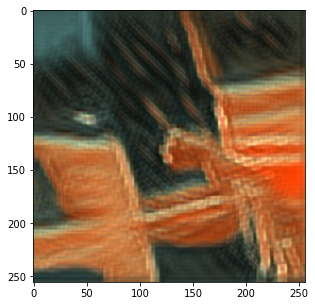

Saved sample stylized image at the_scream/images/sample0_1000.png
========Iteration 1501/25000========
	Content Loss:	596389.44
	Style Loss:	924625.61
	Total Loss:	1521014.44
Time elapsed:	93.67384076118469 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_1500.pth


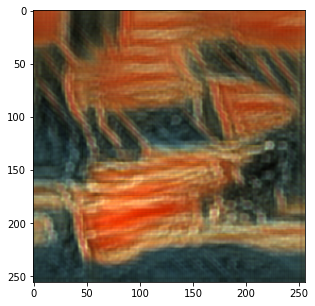

Saved sample stylized image at the_scream/images/sample0_1500.png
========Iteration 2001/25000========
	Content Loss:	585391.88
	Style Loss:	736138.27
	Total Loss:	1321529.32
Time elapsed:	124.83150482177734 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_2000.pth


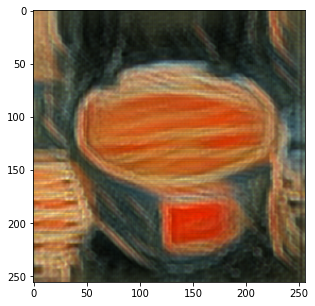

Saved sample stylized image at the_scream/images/sample0_2000.png
========Iteration 2501/25000========
	Content Loss:	575018.88
	Style Loss:	619976.71
	Total Loss:	1194994.83
Time elapsed:	156.03679203987122 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_2500.pth


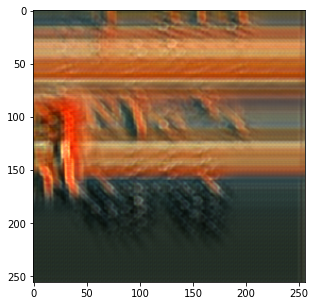

Saved sample stylized image at the_scream/images/sample0_2500.png
========Iteration 3001/25000========
	Content Loss:	567258.38
	Style Loss:	540734.90
	Total Loss:	1107992.31
Time elapsed:	187.22900128364563 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_3000.pth


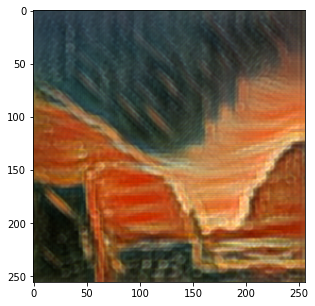

Saved sample stylized image at the_scream/images/sample0_3000.png
========Iteration 3501/25000========
	Content Loss:	561053.88
	Style Loss:	483025.21
	Total Loss:	1044077.98
Time elapsed:	218.3991096019745 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_3500.pth


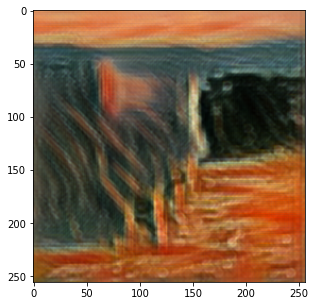

Saved sample stylized image at the_scream/images/sample0_3500.png
========Iteration 4001/25000========
	Content Loss:	556629.00
	Style Loss:	438665.88
	Total Loss:	995293.76
Time elapsed:	249.70303177833557 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_4000.pth


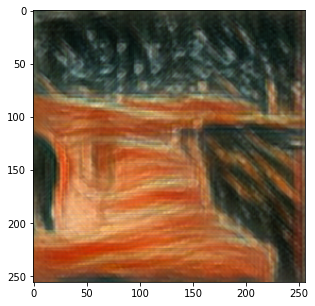

Saved sample stylized image at the_scream/images/sample0_4000.png
========Iteration 4501/25000========
	Content Loss:	554409.38
	Style Loss:	403994.28
	Total Loss:	958402.69
Time elapsed:	280.940908908844 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_4500.pth


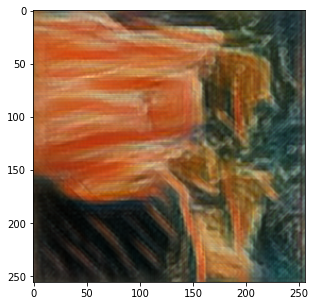

Saved sample stylized image at the_scream/images/sample0_4500.png
========Iteration 5001/25000========
	Content Loss:	548223.69
	Style Loss:	375486.59
	Total Loss:	923709.35
Time elapsed:	312.13131284713745 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_5000.pth


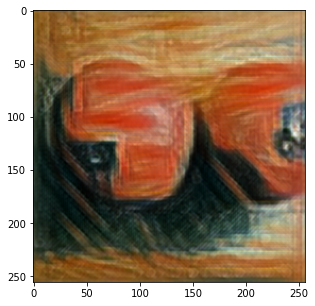

Saved sample stylized image at the_scream/images/sample0_5000.png
========Iteration 5501/25000========
	Content Loss:	545006.38
	Style Loss:	351799.17
	Total Loss:	896804.89
Time elapsed:	343.39028882980347 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_5500.pth


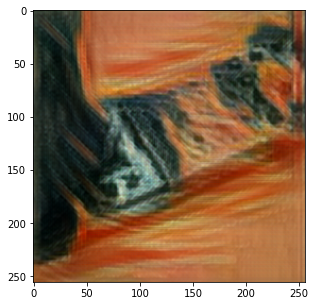

Saved sample stylized image at the_scream/images/sample0_5500.png
========Iteration 6001/25000========
	Content Loss:	540871.56
	Style Loss:	331718.30
	Total Loss:	872589.18
Time elapsed:	374.6178891658783 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_6000.pth


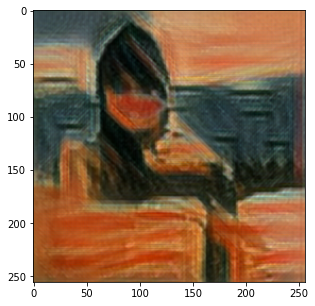

Saved sample stylized image at the_scream/images/sample0_6000.png
========Iteration 6501/25000========
	Content Loss:	538170.88
	Style Loss:	314552.00
	Total Loss:	852721.97
Time elapsed:	405.8709752559662 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_6500.pth


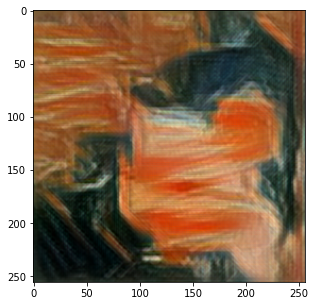

Saved sample stylized image at the_scream/images/sample0_6500.png
========Iteration 7001/25000========
	Content Loss:	535676.88
	Style Loss:	299644.61
	Total Loss:	835320.70
Time elapsed:	437.0747399330139 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_7000.pth


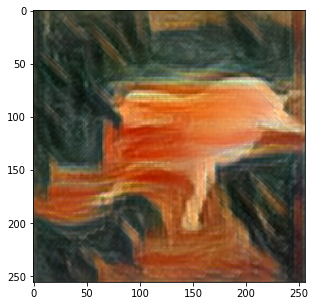

Saved sample stylized image at the_scream/images/sample0_7000.png
========Iteration 7501/25000========
	Content Loss:	533854.38
	Style Loss:	286579.65
	Total Loss:	820432.92
Time elapsed:	468.38185930252075 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_7500.pth


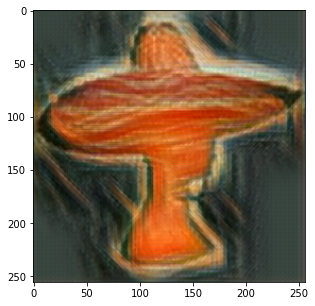

Saved sample stylized image at the_scream/images/sample0_7500.png
========Iteration 8001/25000========
	Content Loss:	532265.62
	Style Loss:	274996.25
	Total Loss:	807260.95
Time elapsed:	499.61679673194885 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_8000.pth


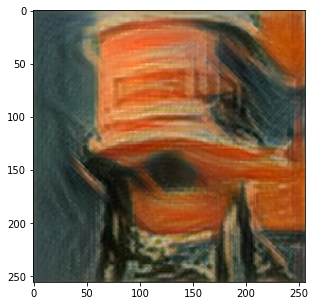

Saved sample stylized image at the_scream/images/sample0_8000.png
========Iteration 8501/25000========
	Content Loss:	530227.69
	Style Loss:	264733.35
	Total Loss:	794960.29
Time elapsed:	530.8238496780396 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_8500.pth


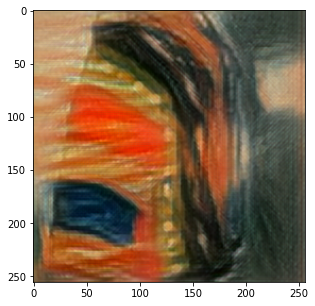

Saved sample stylized image at the_scream/images/sample0_8500.png
========Iteration 9001/25000========
	Content Loss:	527763.25
	Style Loss:	255425.33
	Total Loss:	783188.21
Time elapsed:	562.0731937885284 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_9000.pth


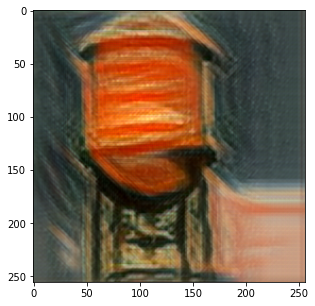

Saved sample stylized image at the_scream/images/sample0_9000.png
========Iteration 9501/25000========
	Content Loss:	526352.00
	Style Loss:	247034.76
	Total Loss:	773386.26
Time elapsed:	593.3463637828827 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_9500.pth


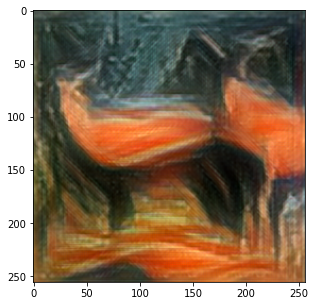

Saved sample stylized image at the_scream/images/sample0_9500.png
========Iteration 10001/25000========
	Content Loss:	524333.50
	Style Loss:	239458.85
	Total Loss:	763792.36
Time elapsed:	624.5938172340393 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_10000.pth


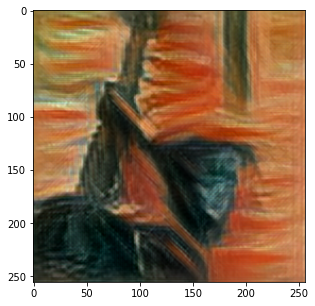

Saved sample stylized image at the_scream/images/sample0_10000.png
========Iteration 10501/25000========
	Content Loss:	522734.75
	Style Loss:	232506.45
	Total Loss:	755241.18
Time elapsed:	655.8676469326019 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_10500.pth


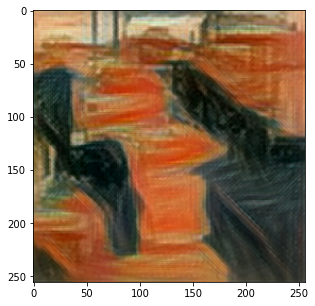

Saved sample stylized image at the_scream/images/sample0_10500.png
========Iteration 11001/25000========
	Content Loss:	521390.41
	Style Loss:	226214.43
	Total Loss:	747604.68
Time elapsed:	687.1556782722473 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_11000.pth


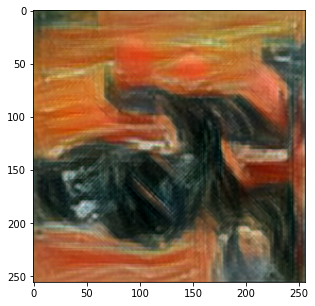

Saved sample stylized image at the_scream/images/sample0_11000.png
========Iteration 11501/25000========
	Content Loss:	520395.72
	Style Loss:	220417.08
	Total Loss:	740813.04
Time elapsed:	718.3809015750885 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_11500.pth


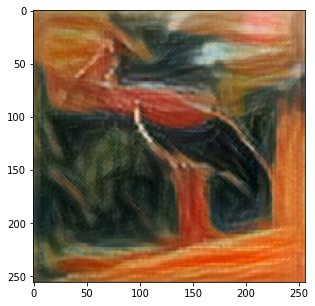

Saved sample stylized image at the_scream/images/sample0_11500.png
========Iteration 12001/25000========
	Content Loss:	519078.38
	Style Loss:	215021.93
	Total Loss:	734100.88
Time elapsed:	749.6071705818176 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_12000.pth


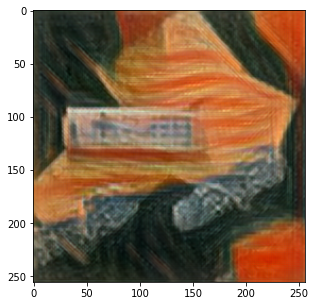

Saved sample stylized image at the_scream/images/sample0_12000.png
========Iteration 12501/25000========
	Content Loss:	518124.06
	Style Loss:	210057.65
	Total Loss:	728182.07
Time elapsed:	780.8035187721252 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_12500.pth


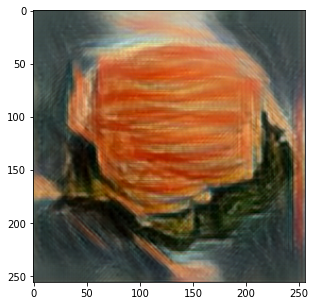

Saved sample stylized image at the_scream/images/sample0_12500.png
========Iteration 13001/25000========
	Content Loss:	517177.47
	Style Loss:	205464.71
	Total Loss:	722642.56
Time elapsed:	811.9759693145752 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_13000.pth


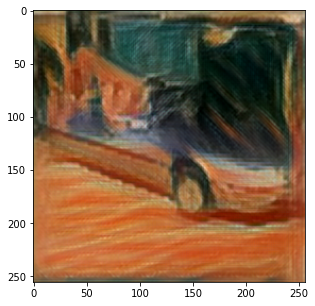

Saved sample stylized image at the_scream/images/sample0_13000.png
========Iteration 13501/25000========
	Content Loss:	515960.41
	Style Loss:	201128.46
	Total Loss:	717089.38
Time elapsed:	843.1538562774658 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_13500.pth


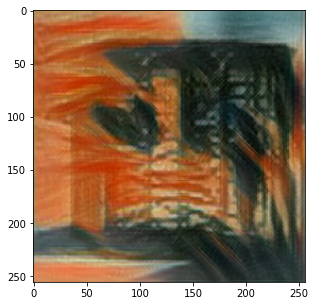

Saved sample stylized image at the_scream/images/sample0_13500.png
========Iteration 14001/25000========
	Content Loss:	515233.78
	Style Loss:	197091.65
	Total Loss:	712325.73
Time elapsed:	874.2973778247833 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_14000.pth


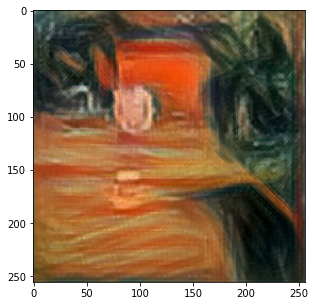

Saved sample stylized image at the_scream/images/sample0_14000.png
========Iteration 14501/25000========
	Content Loss:	513906.00
	Style Loss:	193322.24
	Total Loss:	707228.05
Time elapsed:	905.4225389957428 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_14500.pth


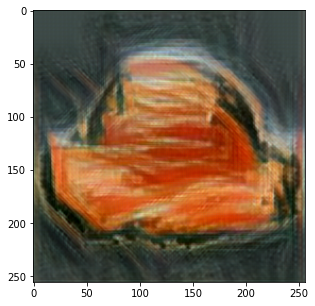

Saved sample stylized image at the_scream/images/sample0_14500.png
========Iteration 15001/25000========
	Content Loss:	512564.34
	Style Loss:	189772.10
	Total Loss:	702336.60
Time elapsed:	936.6517877578735 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_15000.pth


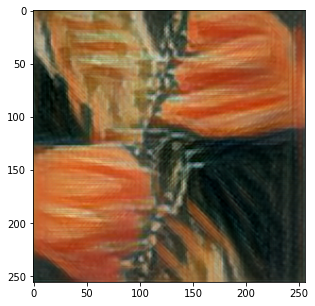

Saved sample stylized image at the_scream/images/sample0_15000.png
========Iteration 15501/25000========
	Content Loss:	511474.62
	Style Loss:	186403.27
	Total Loss:	697878.14
Time elapsed:	967.8997592926025 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_15500.pth


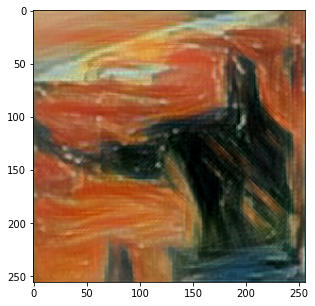

Saved sample stylized image at the_scream/images/sample0_15500.png
========Iteration 16001/25000========
	Content Loss:	510345.34
	Style Loss:	183241.75
	Total Loss:	693587.25
Time elapsed:	999.23397564888 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_16000.pth


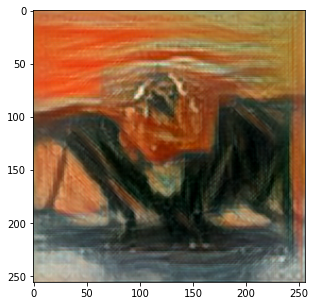

Saved sample stylized image at the_scream/images/sample0_16000.png
========Iteration 16501/25000========
	Content Loss:	509572.84
	Style Loss:	180261.89
	Total Loss:	689835.09
Time elapsed:	1030.5267057418823 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_16500.pth


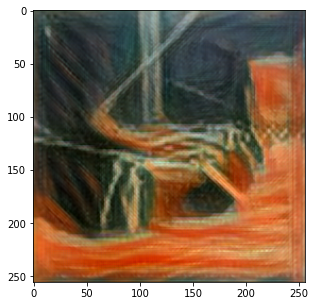

Saved sample stylized image at the_scream/images/sample0_16500.png
========Iteration 17001/25000========
	Content Loss:	508850.97
	Style Loss:	177474.99
	Total Loss:	686326.25
Time elapsed:	1061.9294288158417 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_17000.pth


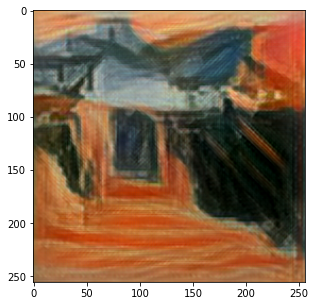

Saved sample stylized image at the_scream/images/sample0_17000.png
========Iteration 17501/25000========
	Content Loss:	507852.16
	Style Loss:	174811.31
	Total Loss:	682663.64
Time elapsed:	1093.2296888828278 seconds
Saved CustomModel checkpoint file at the_scream/models/checkpoint_17500.pth


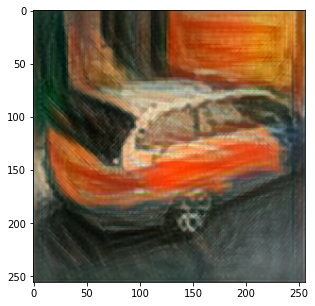

Saved sample stylized image at the_scream/images/sample0_17500.png


In [ ]:
train()

In [ ]:
# copy the models folder to the folder in the google drive
!cp -r the_scream/models/ /content/gdrive/My\ Drive/tinyimagenet_custom/the_scream/
# copy the images folder to the folder in the google drive
!cp -r the_scream/images/ /content/gdrive/My\ Drive/tinyimagenet_custom/the_scream/

## The Shipwreck

In [ ]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = 'tiny-224/train'
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/the_shipwreck.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "the_shipwreck/models/"
SAVE_IMAGE_PATH = "the_shipwreck/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/25000========
	Content Loss:	792234.38
	Style Loss:	20046212.00
	Total Loss:	20838446.00
Time elapsed:	0.2301654815673828 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_0.pth


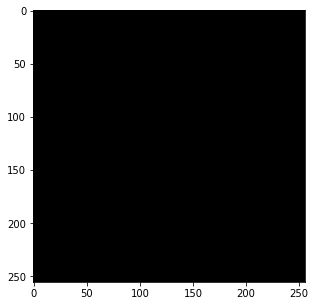

Saved sample stylized image at the_shipwreck/images/sample0_0.png
========Iteration 501/25000========
	Content Loss:	563553.00
	Style Loss:	1694990.08
	Total Loss:	2258542.86
Time elapsed:	35.879260540008545 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_500.pth


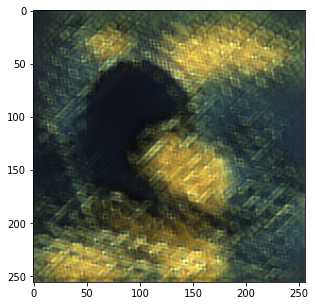

Saved sample stylized image at the_shipwreck/images/sample0_500.png
========Iteration 1001/25000========
	Content Loss:	531954.19
	Style Loss:	950124.63
	Total Loss:	1482078.93
Time elapsed:	71.62761187553406 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_1000.pth


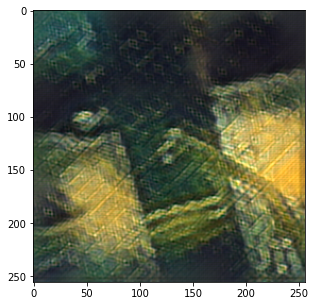

Saved sample stylized image at the_shipwreck/images/sample0_1000.png
========Iteration 1501/25000========
	Content Loss:	513747.47
	Style Loss:	685643.14
	Total Loss:	1199390.90
Time elapsed:	107.35056281089783 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_1500.pth


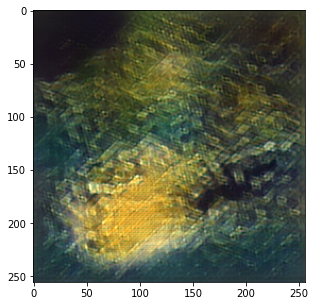

Saved sample stylized image at the_shipwreck/images/sample0_1500.png
========Iteration 2001/25000========
	Content Loss:	499938.88
	Style Loss:	547969.42
	Total Loss:	1047909.03
Time elapsed:	143.03813672065735 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_2000.pth


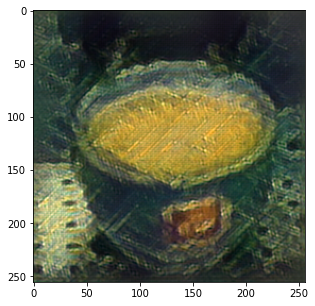

Saved sample stylized image at the_shipwreck/images/sample0_2000.png
========Iteration 2501/25000========
	Content Loss:	488559.12
	Style Loss:	463556.36
	Total Loss:	952116.07
Time elapsed:	178.6887171268463 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_2500.pth


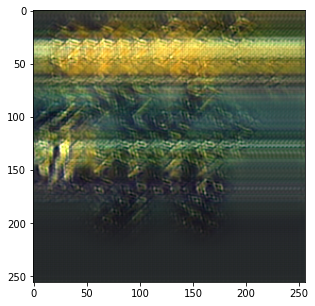

Saved sample stylized image at the_shipwreck/images/sample0_2500.png
========Iteration 3001/25000========
	Content Loss:	480156.62
	Style Loss:	405306.27
	Total Loss:	885463.56
Time elapsed:	214.34243988990784 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_3000.pth


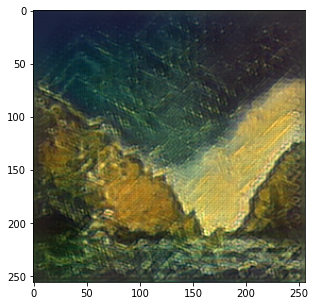

Saved sample stylized image at the_shipwreck/images/sample0_3000.png
========Iteration 3501/25000========
	Content Loss:	474229.47
	Style Loss:	362670.15
	Total Loss:	836900.00
Time elapsed:	250.0112864971161 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_3500.pth


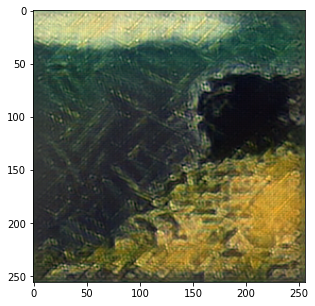

Saved sample stylized image at the_shipwreck/images/sample0_3500.png
========Iteration 4001/25000========
	Content Loss:	469822.22
	Style Loss:	330026.55
	Total Loss:	799849.48
Time elapsed:	285.6729347705841 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_4000.pth


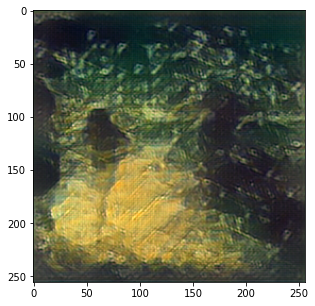

Saved sample stylized image at the_shipwreck/images/sample0_4000.png
========Iteration 4501/25000========
	Content Loss:	467556.41
	Style Loss:	304378.01
	Total Loss:	771935.01
Time elapsed:	321.34662199020386 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_4500.pth


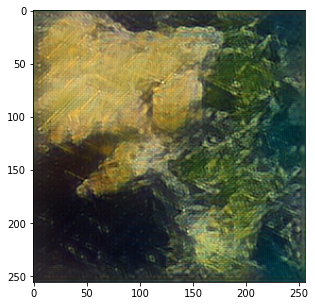

Saved sample stylized image at the_shipwreck/images/sample0_4500.png
========Iteration 5001/25000========
	Content Loss:	462117.00
	Style Loss:	283553.31
	Total Loss:	745670.73
Time elapsed:	356.8819668292999 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_5000.pth


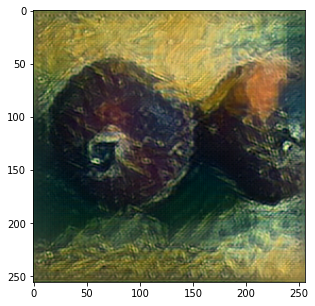

Saved sample stylized image at the_shipwreck/images/sample0_5000.png
========Iteration 5501/25000========
	Content Loss:	458568.84
	Style Loss:	266103.44
	Total Loss:	724672.65
Time elapsed:	392.47633719444275 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_5500.pth


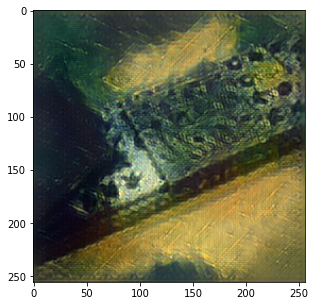

Saved sample stylized image at the_shipwreck/images/sample0_5500.png
========Iteration 6001/25000========
	Content Loss:	454371.34
	Style Loss:	251383.54
	Total Loss:	705755.53
Time elapsed:	428.03497648239136 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_6000.pth


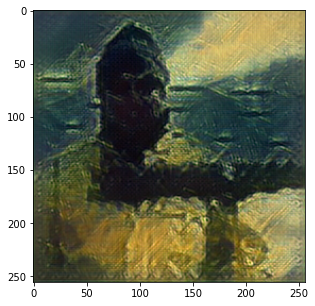

Saved sample stylized image at the_shipwreck/images/sample0_6000.png
========Iteration 6501/25000========
	Content Loss:	452090.34
	Style Loss:	239050.14
	Total Loss:	691141.21
Time elapsed:	463.612092256546 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_6500.pth


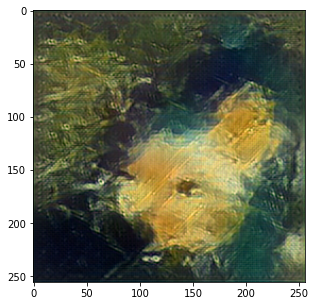

Saved sample stylized image at the_shipwreck/images/sample0_6500.png
========Iteration 7001/25000========
	Content Loss:	449694.94
	Style Loss:	228183.55
	Total Loss:	677878.95
Time elapsed:	499.22629952430725 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_7000.pth


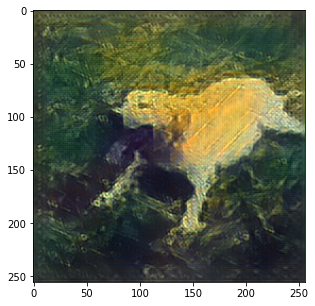

Saved sample stylized image at the_shipwreck/images/sample0_7000.png
========Iteration 7501/25000========
	Content Loss:	447889.22
	Style Loss:	218653.63
	Total Loss:	666542.86
Time elapsed:	534.9076981544495 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_7500.pth


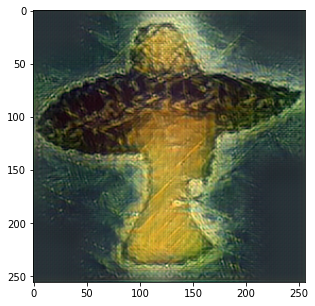

Saved sample stylized image at the_shipwreck/images/sample0_7500.png
========Iteration 8001/25000========
	Content Loss:	446352.94
	Style Loss:	210187.38
	Total Loss:	656540.14
Time elapsed:	570.5792419910431 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_8000.pth


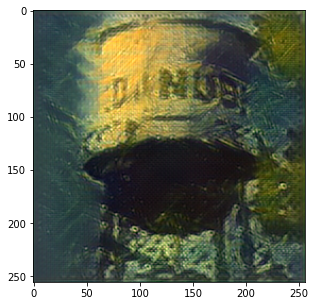

Saved sample stylized image at the_shipwreck/images/sample0_8000.png
========Iteration 8501/25000========
	Content Loss:	444453.44
	Style Loss:	202667.15
	Total Loss:	647120.18
Time elapsed:	606.2467176914215 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_8500.pth


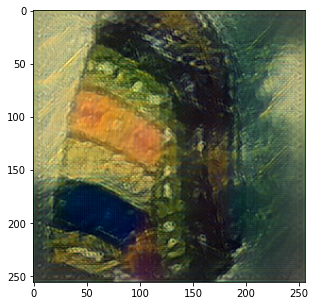

Saved sample stylized image at the_shipwreck/images/sample0_8500.png
========Iteration 9001/25000========
	Content Loss:	441959.22
	Style Loss:	195921.23
	Total Loss:	637879.81
Time elapsed:	641.9896900653839 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_9000.pth


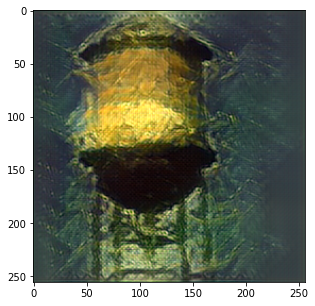

Saved sample stylized image at the_shipwreck/images/sample0_9000.png
========Iteration 9501/25000========
	Content Loss:	440362.28
	Style Loss:	189814.08
	Total Loss:	630176.15
Time elapsed:	677.6890408992767 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_9500.pth


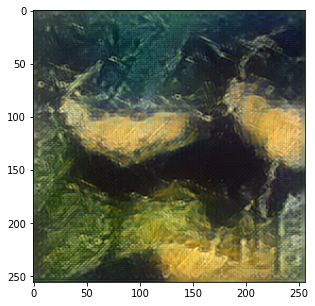

Saved sample stylized image at the_shipwreck/images/sample0_9500.png
========Iteration 10001/25000========
	Content Loss:	438702.03
	Style Loss:	184331.36
	Total Loss:	623033.00
Time elapsed:	713.3834676742554 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_10000.pth


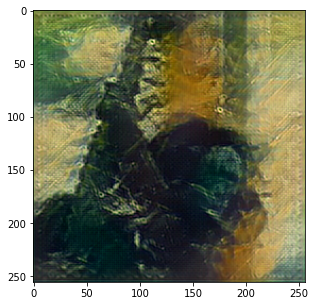

Saved sample stylized image at the_shipwreck/images/sample0_10000.png
========Iteration 10501/25000========
	Content Loss:	437155.47
	Style Loss:	179313.65
	Total Loss:	616468.72
Time elapsed:	749.071879863739 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_10500.pth


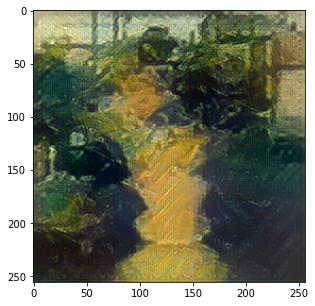

Saved sample stylized image at the_shipwreck/images/sample0_10500.png
========Iteration 11001/25000========
	Content Loss:	435674.47
	Style Loss:	174700.25
	Total Loss:	610373.88
Time elapsed:	784.742413520813 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_11000.pth


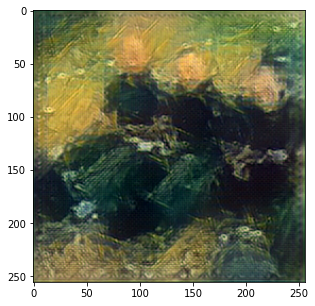

Saved sample stylized image at the_shipwreck/images/sample0_11000.png
========Iteration 11501/25000========
	Content Loss:	434647.53
	Style Loss:	170557.72
	Total Loss:	605204.54
Time elapsed:	820.420815706253 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_11500.pth


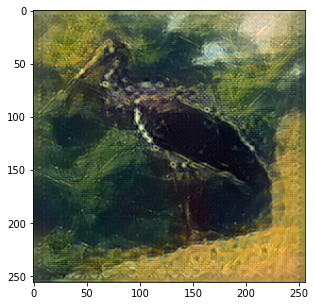

Saved sample stylized image at the_shipwreck/images/sample0_11500.png
========Iteration 12001/25000========
	Content Loss:	433074.75
	Style Loss:	166681.69
	Total Loss:	599755.26
Time elapsed:	856.0906870365143 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_12000.pth


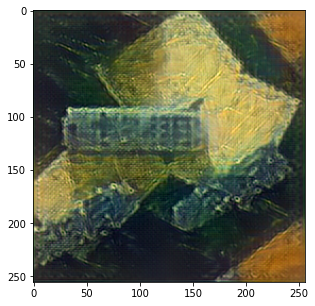

Saved sample stylized image at the_shipwreck/images/sample0_12000.png
========Iteration 12501/25000========
	Content Loss:	432030.25
	Style Loss:	163081.85
	Total Loss:	595110.98
Time elapsed:	891.7641065120697 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_12500.pth


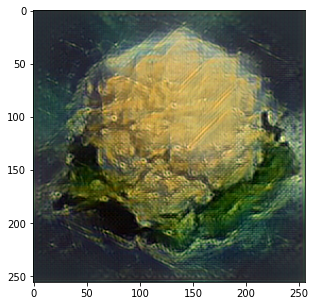

Saved sample stylized image at the_shipwreck/images/sample0_12500.png
========Iteration 13001/25000========
	Content Loss:	431244.94
	Style Loss:	159781.60
	Total Loss:	591025.71
Time elapsed:	927.4513611793518 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_13000.pth


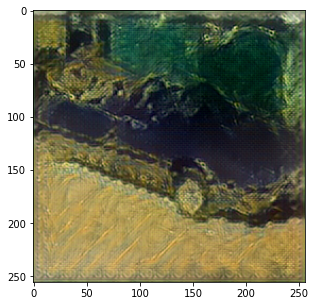

Saved sample stylized image at the_shipwreck/images/sample0_13000.png
========Iteration 13501/25000========
	Content Loss:	430024.59
	Style Loss:	156629.12
	Total Loss:	586652.89
Time elapsed:	963.1341600418091 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_13500.pth


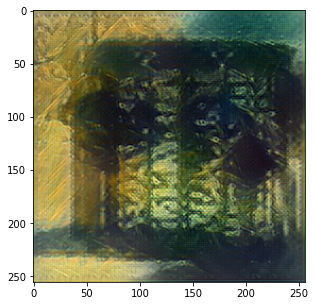

Saved sample stylized image at the_shipwreck/images/sample0_13500.png
========Iteration 14001/25000========
	Content Loss:	429147.38
	Style Loss:	153703.63
	Total Loss:	582850.58
Time elapsed:	998.8285059928894 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_14000.pth


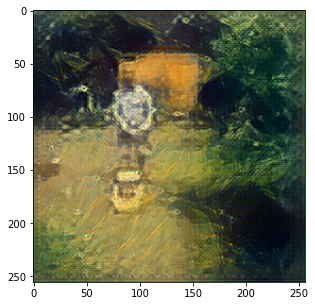

Saved sample stylized image at the_shipwreck/images/sample0_14000.png
========Iteration 14501/25000========
	Content Loss:	428104.75
	Style Loss:	151041.68
	Total Loss:	579146.00
Time elapsed:	1034.5176584720612 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_14500.pth


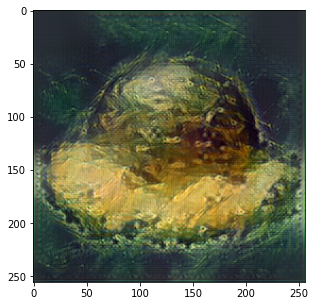

Saved sample stylized image at the_shipwreck/images/sample0_14500.png
========Iteration 15001/25000========
	Content Loss:	426900.03
	Style Loss:	148508.90
	Total Loss:	575408.97
Time elapsed:	1070.2141501903534 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_15000.pth


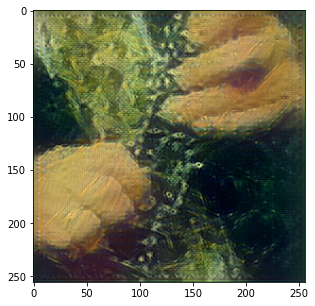

Saved sample stylized image at the_shipwreck/images/sample0_15000.png
========Iteration 15501/25000========
	Content Loss:	425807.81
	Style Loss:	146065.55
	Total Loss:	571873.35
Time elapsed:	1105.8576345443726 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_15500.pth


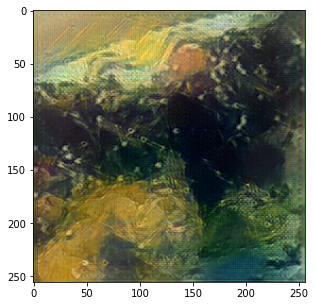

Saved sample stylized image at the_shipwreck/images/sample0_15500.png
========Iteration 16001/25000========
	Content Loss:	424824.50
	Style Loss:	143772.76
	Total Loss:	568597.26
Time elapsed:	1141.4684870243073 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_16000.pth


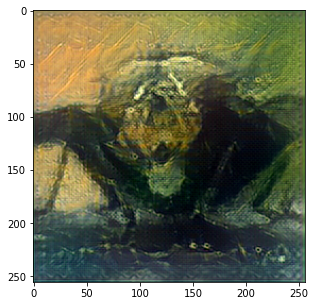

Saved sample stylized image at the_shipwreck/images/sample0_16000.png
========Iteration 16501/25000========
	Content Loss:	424071.75
	Style Loss:	141641.33
	Total Loss:	565712.73
Time elapsed:	1177.0942947864532 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_16500.pth


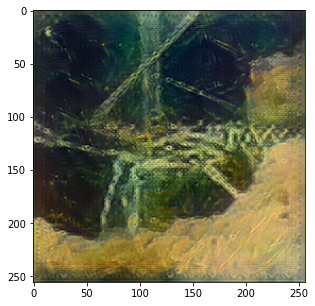

Saved sample stylized image at the_shipwreck/images/sample0_16500.png
========Iteration 17001/25000========
	Content Loss:	423389.84
	Style Loss:	139617.57
	Total Loss:	563007.32
Time elapsed:	1212.713853597641 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_17000.pth


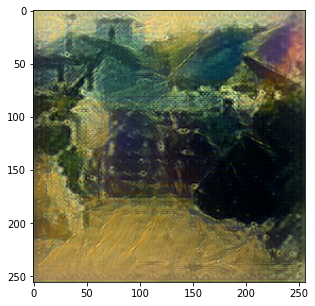

Saved sample stylized image at the_shipwreck/images/sample0_17000.png
========Iteration 17501/25000========
	Content Loss:	422411.59
	Style Loss:	137710.40
	Total Loss:	560122.07
Time elapsed:	1248.3230171203613 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_17500.pth


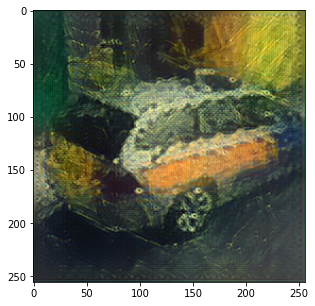

Saved sample stylized image at the_shipwreck/images/sample0_17500.png
========Iteration 18001/25000========
	Content Loss:	421758.00
	Style Loss:	135954.47
	Total Loss:	557712.60
Time elapsed:	1283.9280292987823 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_18000.pth


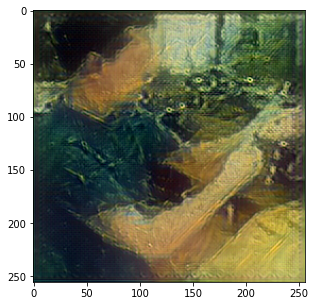

Saved sample stylized image at the_shipwreck/images/sample0_18000.png
========Iteration 18501/25000========
	Content Loss:	420794.09
	Style Loss:	134220.78
	Total Loss:	555014.99
Time elapsed:	1319.6572959423065 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_18500.pth


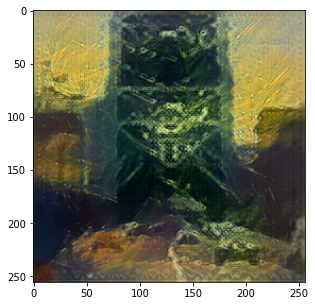

Saved sample stylized image at the_shipwreck/images/sample0_18500.png
========Iteration 19001/25000========
	Content Loss:	420328.09
	Style Loss:	132578.51
	Total Loss:	552906.63
Time elapsed:	1355.2605142593384 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_19000.pth


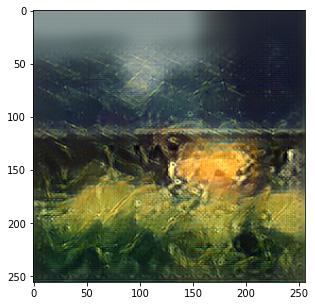

Saved sample stylized image at the_shipwreck/images/sample0_19000.png
========Iteration 19501/25000========
	Content Loss:	419400.41
	Style Loss:	131012.34
	Total Loss:	550412.77
Time elapsed:	1390.8830320835114 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_19500.pth


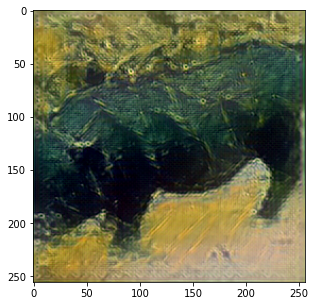

Saved sample stylized image at the_shipwreck/images/sample0_19500.png
========Iteration 20001/25000========
	Content Loss:	418774.56
	Style Loss:	129507.19
	Total Loss:	548281.74
Time elapsed:	1426.6081449985504 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_20000.pth


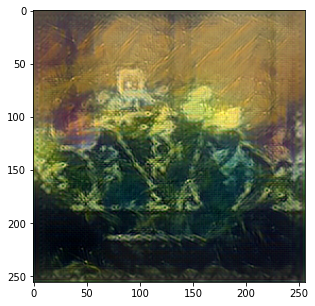

Saved sample stylized image at the_shipwreck/images/sample0_20000.png
========Iteration 20501/25000========
	Content Loss:	418151.44
	Style Loss:	128060.06
	Total Loss:	546211.63
Time elapsed:	1462.3315870761871 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_20500.pth


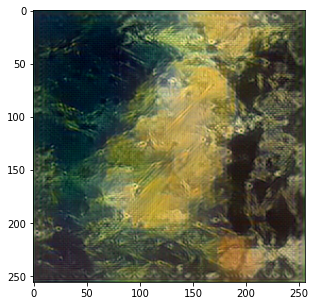

Saved sample stylized image at the_shipwreck/images/sample0_20500.png
========Iteration 21001/25000========
	Content Loss:	417681.41
	Style Loss:	126690.59
	Total Loss:	544372.13
Time elapsed:	1498.0624225139618 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_21000.pth


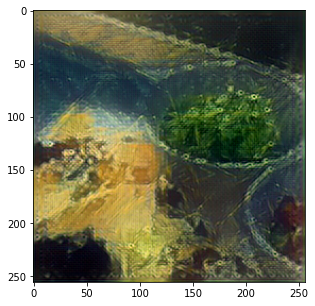

Saved sample stylized image at the_shipwreck/images/sample0_21000.png
========Iteration 21501/25000========
	Content Loss:	417201.91
	Style Loss:	125375.63
	Total Loss:	542577.62
Time elapsed:	1533.7866232395172 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_21500.pth


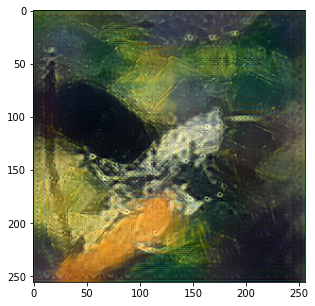

Saved sample stylized image at the_shipwreck/images/sample0_21500.png
========Iteration 22001/25000========
	Content Loss:	416468.53
	Style Loss:	124136.48
	Total Loss:	540604.91
Time elapsed:	1569.532383441925 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_22000.pth


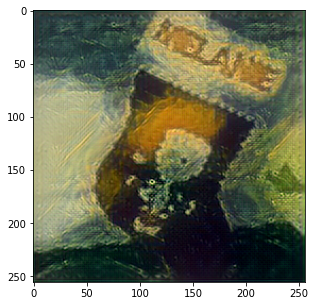

Saved sample stylized image at the_shipwreck/images/sample0_22000.png
========Iteration 22501/25000========
	Content Loss:	415833.56
	Style Loss:	122928.39
	Total Loss:	538762.15
Time elapsed:	1605.2821638584137 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_22500.pth


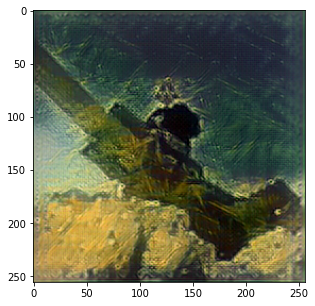

Saved sample stylized image at the_shipwreck/images/sample0_22500.png
========Iteration 23001/25000========
	Content Loss:	415507.75
	Style Loss:	121797.97
	Total Loss:	537305.97
Time elapsed:	1640.9941685199738 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_23000.pth


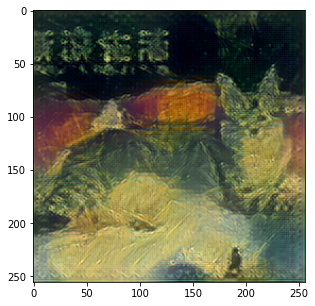

Saved sample stylized image at the_shipwreck/images/sample0_23000.png
========Iteration 23501/25000========
	Content Loss:	414614.72
	Style Loss:	120664.52
	Total Loss:	535279.52
Time elapsed:	1676.7114005088806 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_23500.pth


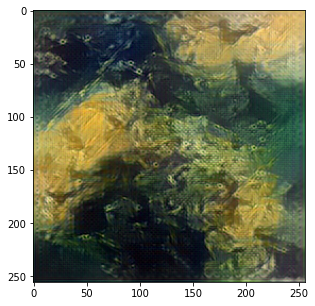

Saved sample stylized image at the_shipwreck/images/sample0_23500.png
========Iteration 24001/25000========
	Content Loss:	413908.66
	Style Loss:	119596.58
	Total Loss:	533505.72
Time elapsed:	1712.443748474121 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_24000.pth


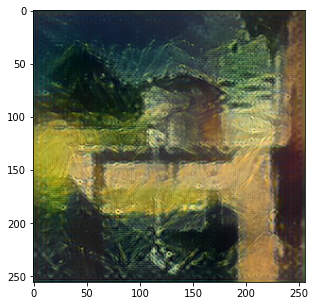

Saved sample stylized image at the_shipwreck/images/sample0_24000.png
========Iteration 24501/25000========
	Content Loss:	413628.88
	Style Loss:	118574.13
	Total Loss:	532203.12
Time elapsed:	1748.2102890014648 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_24500.pth


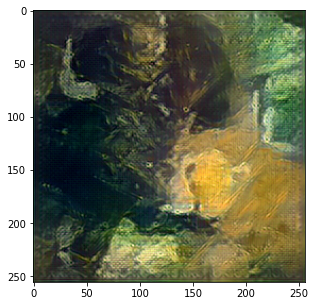

Saved sample stylized image at the_shipwreck/images/sample0_24500.png
========Iteration 25000/25000========
	Content Loss:	413089.94
	Style Loss:	117592.72
	Total Loss:	530682.93
Time elapsed:	1783.9016525745392 seconds
Saved CustomModel checkpoint file at the_shipwreck/models/checkpoint_24999.pth


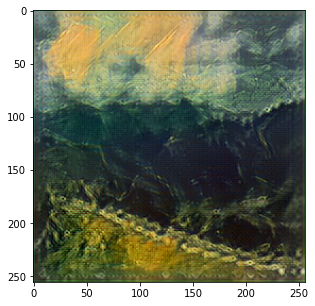

Saved sample stylized image at the_shipwreck/images/sample0_24999.png
Done Training the Network!
Training Time: 1784.1286208629608 seconds
========Content Loss========
[20838446.0, 2258542.8587824353, 1482078.934346903, 1199390.9032519986, 1047909.0299225388, 952116.0725084966, 885463.5571996834, 836899.9970544131, 799849.4762012622, 771935.0067137858, 745670.7343218856, 724672.654477595, 705755.534551533, 691141.2121644747, 677878.9475342808, 666542.8565732902, 656540.1441968192, 647120.175056611, 637879.8118542384, 630176.1472838386, 623032.9998937607, 616468.7199195315, 610373.8793149487, 605204.544115729, 599755.2647383552, 595110.9766418687, 591025.7122697292, 586652.893665284, 582850.5763204414, 579145.9996034757, 575408.9693207953, 571873.3524833075, 568597.2586205549, 565712.7256946549, 563007.3157314275, 560122.0727119164, 557712.6047858453, 555014.9917808496, 552906.633991303, 550412.7653501744, 548281.7413184028, 546211.6319074375, 544372.1271896278, 542577.624811782, 540604

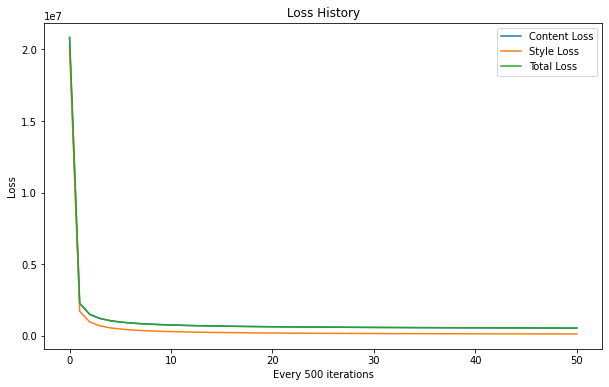

In [19]:
train()

In [20]:
# copy the models folder to the folder in the google drive
!cp -r the_shipwreck/models/ /content/gdrive/My\ Drive/tinyimagenet_custom/the_shipwreck/
# copy the images folder to the folder in the google drive
!cp -r the_shipwreck/images/ /content/gdrive/My\ Drive/tinyimagenet_custom/the_shipwreck/

## Wave

In [21]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = 'tiny-224/train'
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/wave.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "wave/models/"
SAVE_IMAGE_PATH = "wave/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/25000========
	Content Loss:	792234.38
	Style Loss:	38423524.00
	Total Loss:	39215760.00
Time elapsed:	0.1950380802154541 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_0.pth


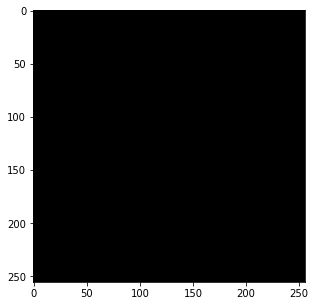

Saved sample stylized image at wave/images/sample0_0.png
========Iteration 501/25000========
	Content Loss:	689555.12
	Style Loss:	5854899.65
	Total Loss:	6544454.83
Time elapsed:	37.74773287773132 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_500.pth


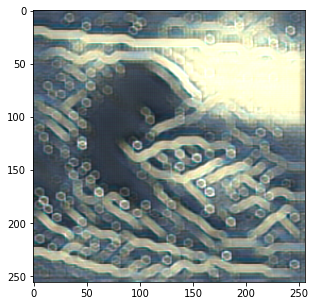

Saved sample stylized image at wave/images/sample0_500.png
========Iteration 1001/25000========
	Content Loss:	663700.44
	Style Loss:	3258652.14
	Total Loss:	3922352.81
Time elapsed:	75.29562425613403 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_1000.pth


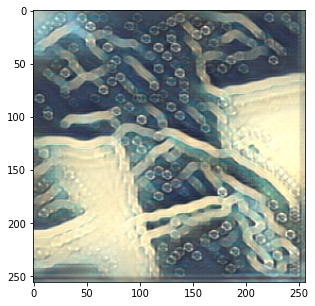

Saved sample stylized image at wave/images/sample0_1000.png
========Iteration 1501/25000========
	Content Loss:	648305.81
	Style Loss:	2323175.34
	Total Loss:	2971481.50
Time elapsed:	112.99684190750122 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_1500.pth


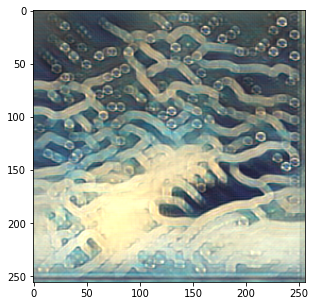

Saved sample stylized image at wave/images/sample0_1500.png
========Iteration 2001/25000========
	Content Loss:	636006.94
	Style Loss:	1832394.16
	Total Loss:	2468401.21
Time elapsed:	150.5621953010559 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_2000.pth


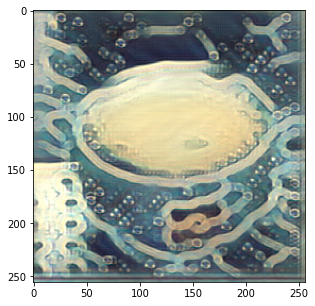

Saved sample stylized image at wave/images/sample0_2000.png
========Iteration 2501/25000========
	Content Loss:	624101.06
	Style Loss:	1526072.30
	Total Loss:	2150173.51
Time elapsed:	188.142019033432 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_2500.pth


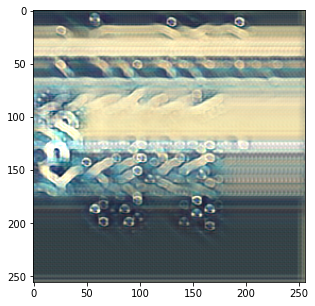

Saved sample stylized image at wave/images/sample0_2500.png
========Iteration 3001/25000========
	Content Loss:	614848.50
	Style Loss:	1315378.41
	Total Loss:	1930227.41
Time elapsed:	225.729022026062 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_3000.pth


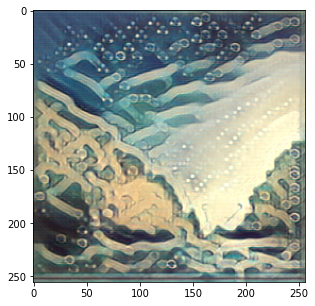

Saved sample stylized image at wave/images/sample0_3000.png
========Iteration 3501/25000========
	Content Loss:	607353.19
	Style Loss:	1161090.02
	Total Loss:	1768444.34
Time elapsed:	263.31180715560913 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_3500.pth


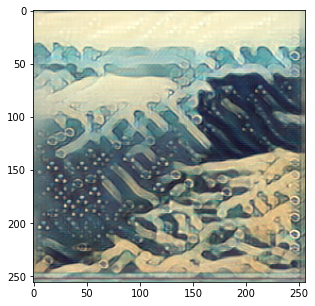

Saved sample stylized image at wave/images/sample0_3500.png
========Iteration 4001/25000========
	Content Loss:	600908.00
	Style Loss:	1043010.64
	Total Loss:	1643920.20
Time elapsed:	300.89157724380493 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_4000.pth


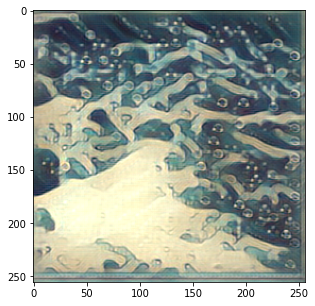

Saved sample stylized image at wave/images/sample0_4000.png
========Iteration 4501/25000========
	Content Loss:	596613.50
	Style Loss:	950559.69
	Total Loss:	1547174.88
Time elapsed:	338.4824857711792 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_4500.pth


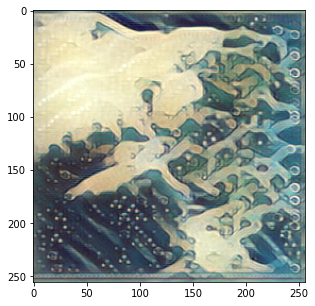

Saved sample stylized image at wave/images/sample0_4500.png
========Iteration 5001/25000========
	Content Loss:	590011.75
	Style Loss:	875020.67
	Total Loss:	1465034.23
Time elapsed:	376.07391715049744 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_5000.pth


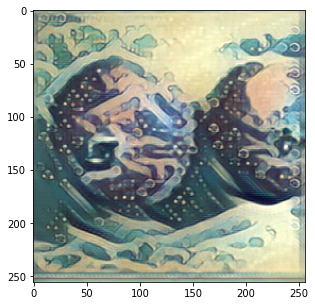

Saved sample stylized image at wave/images/sample0_5000.png
========Iteration 5501/25000========
	Content Loss:	584796.31
	Style Loss:	812171.65
	Total Loss:	1396969.47
Time elapsed:	413.6768252849579 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_5500.pth


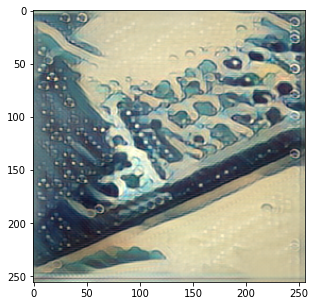

Saved sample stylized image at wave/images/sample0_5500.png
========Iteration 6001/25000========
	Content Loss:	579548.94
	Style Loss:	759444.73
	Total Loss:	1338995.39
Time elapsed:	451.2942819595337 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_6000.pth


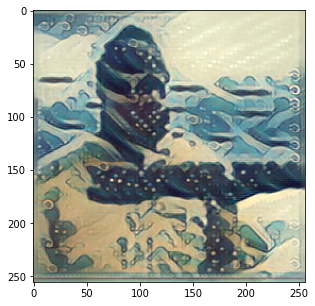

Saved sample stylized image at wave/images/sample0_6000.png
========Iteration 6501/25000========
	Content Loss:	575237.38
	Style Loss:	714589.38
	Total Loss:	1289828.22
Time elapsed:	488.93815088272095 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_6500.pth


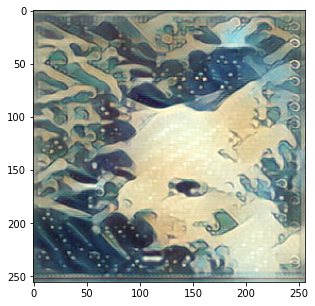

Saved sample stylized image at wave/images/sample0_6500.png
========Iteration 7001/25000========
	Content Loss:	571619.62
	Style Loss:	675784.55
	Total Loss:	1247405.43
Time elapsed:	526.5290811061859 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_7000.pth


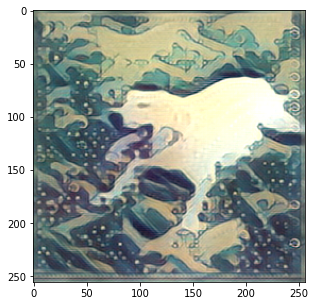

Saved sample stylized image at wave/images/sample0_7000.png
========Iteration 7501/25000========
	Content Loss:	568402.12
	Style Loss:	641703.02
	Total Loss:	1210105.94
Time elapsed:	564.1387042999268 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_7500.pth


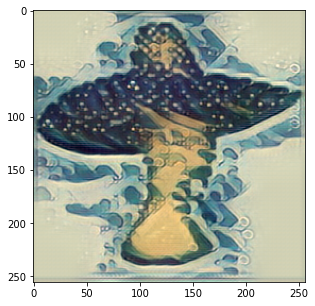

Saved sample stylized image at wave/images/sample0_7500.png
========Iteration 8001/25000========
	Content Loss:	565597.12
	Style Loss:	611586.00
	Total Loss:	1177183.73
Time elapsed:	601.750048160553 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_8000.pth


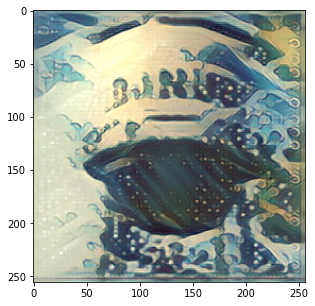

Saved sample stylized image at wave/images/sample0_8000.png
========Iteration 8501/25000========
	Content Loss:	562611.56
	Style Loss:	584926.60
	Total Loss:	1147538.02
Time elapsed:	639.3101360797882 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_8500.pth


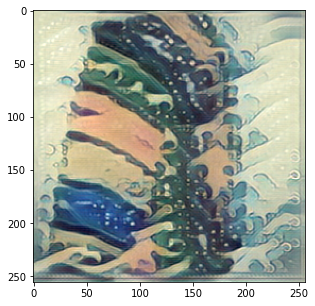

Saved sample stylized image at wave/images/sample0_8500.png
========Iteration 9001/25000========
	Content Loss:	559057.50
	Style Loss:	561016.59
	Total Loss:	1120074.11
Time elapsed:	676.8366913795471 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_9000.pth


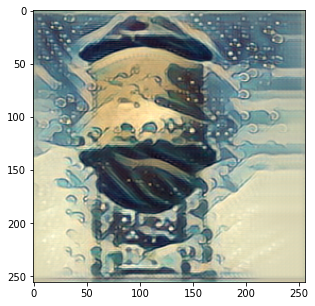

Saved sample stylized image at wave/images/sample0_9000.png
========Iteration 9501/25000========
	Content Loss:	556220.88
	Style Loss:	539436.06
	Total Loss:	1095657.13
Time elapsed:	714.3613557815552 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_9500.pth


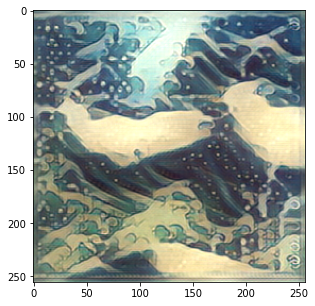

Saved sample stylized image at wave/images/sample0_9500.png
========Iteration 10001/25000========
	Content Loss:	553874.25
	Style Loss:	519879.40
	Total Loss:	1073753.86
Time elapsed:	751.8526027202606 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_10000.pth


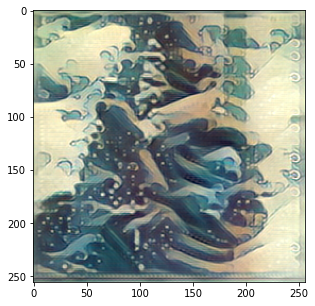

Saved sample stylized image at wave/images/sample0_10000.png
========Iteration 10501/25000========
	Content Loss:	551436.56
	Style Loss:	502096.05
	Total Loss:	1053533.03
Time elapsed:	789.3110957145691 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_10500.pth


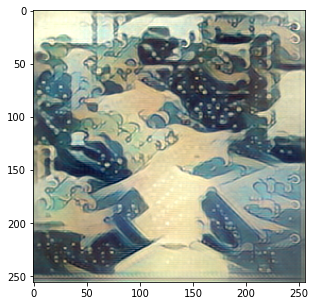

Saved sample stylized image at wave/images/sample0_10500.png
========Iteration 11001/25000========
	Content Loss:	549117.81
	Style Loss:	485870.38
	Total Loss:	1034988.71
Time elapsed:	826.8530187606812 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_11000.pth


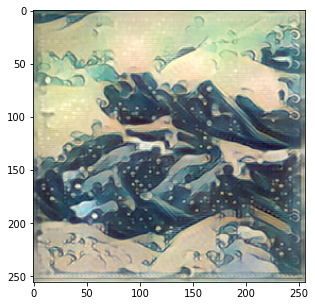

Saved sample stylized image at wave/images/sample0_11000.png
========Iteration 11501/25000========
	Content Loss:	547131.62
	Style Loss:	470969.21
	Total Loss:	1018101.58
Time elapsed:	864.3175325393677 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_11500.pth


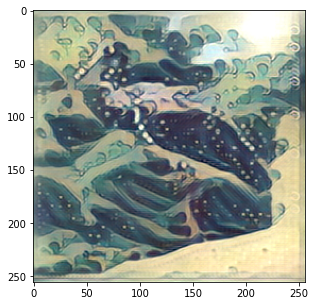

Saved sample stylized image at wave/images/sample0_11500.png
========Iteration 12001/25000========
	Content Loss:	544757.88
	Style Loss:	457285.17
	Total Loss:	1002043.75
Time elapsed:	901.7731201648712 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_12000.pth


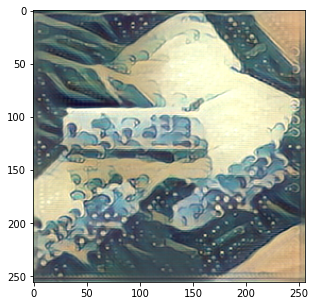

Saved sample stylized image at wave/images/sample0_12000.png
========Iteration 12501/25000========
	Content Loss:	542963.94
	Style Loss:	444604.86
	Total Loss:	987569.01
Time elapsed:	939.2239527702332 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_12500.pth


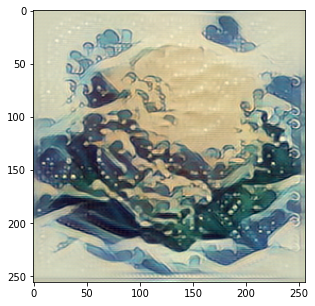

Saved sample stylized image at wave/images/sample0_12500.png
========Iteration 13001/25000========
	Content Loss:	541621.75
	Style Loss:	432899.67
	Total Loss:	974521.78
Time elapsed:	976.684380531311 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_13000.pth


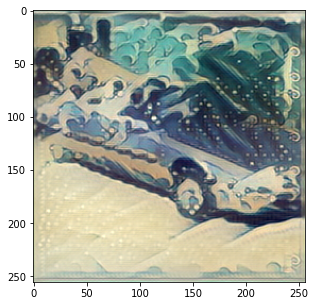

Saved sample stylized image at wave/images/sample0_13000.png
========Iteration 13501/25000========
	Content Loss:	539782.94
	Style Loss:	421970.05
	Total Loss:	961753.62
Time elapsed:	1014.1579921245575 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_13500.pth


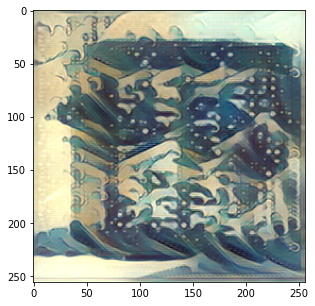

Saved sample stylized image at wave/images/sample0_13500.png
========Iteration 14001/25000========
	Content Loss:	538286.06
	Style Loss:	411738.38
	Total Loss:	950025.30
Time elapsed:	1051.590657711029 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_14000.pth


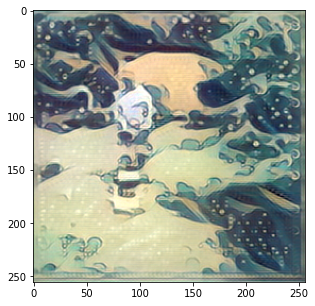

Saved sample stylized image at wave/images/sample0_14000.png
========Iteration 14501/25000========
	Content Loss:	536801.44
	Style Loss:	402270.47
	Total Loss:	939072.72
Time elapsed:	1089.0511922836304 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_14500.pth


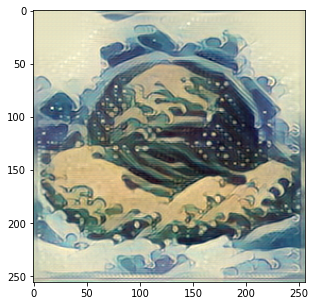

Saved sample stylized image at wave/images/sample0_14500.png
========Iteration 15001/25000========
	Content Loss:	535189.69
	Style Loss:	393436.44
	Total Loss:	928626.91
Time elapsed:	1126.4935765266418 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_15000.pth


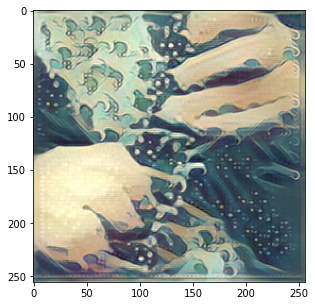

Saved sample stylized image at wave/images/sample0_15000.png
========Iteration 15501/25000========
	Content Loss:	533737.62
	Style Loss:	385033.63
	Total Loss:	918772.54
Time elapsed:	1163.9642910957336 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_15500.pth


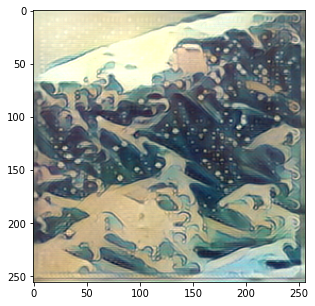

Saved sample stylized image at wave/images/sample0_15500.png
========Iteration 16001/25000========
	Content Loss:	532439.56
	Style Loss:	377080.51
	Total Loss:	909521.07
Time elapsed:	1201.4121673107147 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_16000.pth


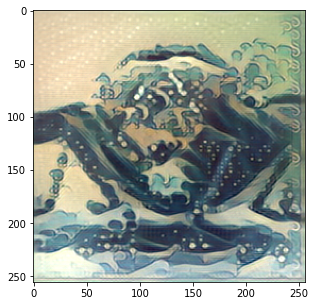

Saved sample stylized image at wave/images/sample0_16000.png
========Iteration 16501/25000========
	Content Loss:	531138.50
	Style Loss:	369611.50
	Total Loss:	900750.31
Time elapsed:	1238.8723385334015 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_16500.pth


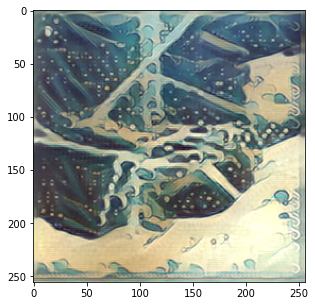

Saved sample stylized image at wave/images/sample0_16500.png
========Iteration 17001/25000========
	Content Loss:	530133.56
	Style Loss:	362552.06
	Total Loss:	892685.84
Time elapsed:	1276.2917592525482 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_17000.pth


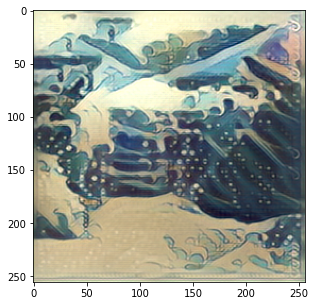

Saved sample stylized image at wave/images/sample0_17000.png
========Iteration 17501/25000========
	Content Loss:	528793.69
	Style Loss:	355886.01
	Total Loss:	884680.00
Time elapsed:	1313.7331759929657 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_17500.pth


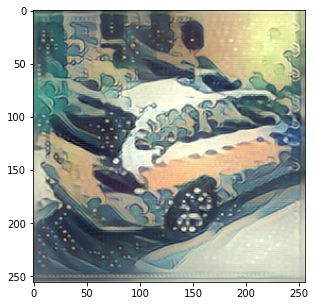

Saved sample stylized image at wave/images/sample0_17500.png
========Iteration 18001/25000========
	Content Loss:	527860.38
	Style Loss:	349697.69
	Total Loss:	877558.02
Time elapsed:	1351.1684832572937 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_18000.pth


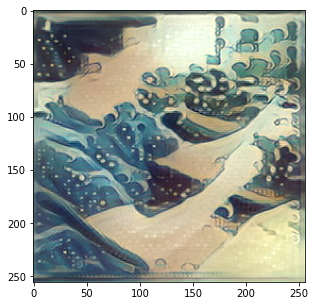

Saved sample stylized image at wave/images/sample0_18000.png
========Iteration 18501/25000========
	Content Loss:	526482.25
	Style Loss:	343716.76
	Total Loss:	870198.92
Time elapsed:	1388.6080899238586 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_18500.pth


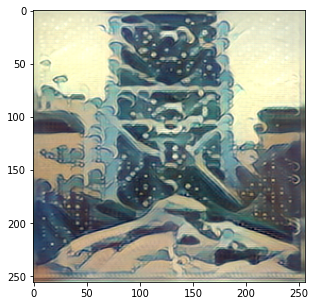

Saved sample stylized image at wave/images/sample0_18500.png
========Iteration 19001/25000========
	Content Loss:	525736.75
	Style Loss:	338020.92
	Total Loss:	863757.40
Time elapsed:	1426.0262792110443 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_19000.pth


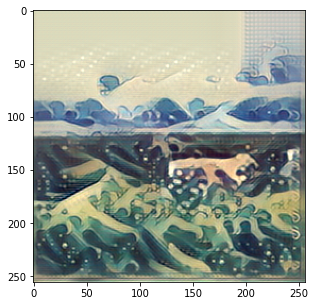

Saved sample stylized image at wave/images/sample0_19000.png
========Iteration 19501/25000========
	Content Loss:	524473.75
	Style Loss:	332578.67
	Total Loss:	857051.89
Time elapsed:	1463.4530277252197 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_19500.pth


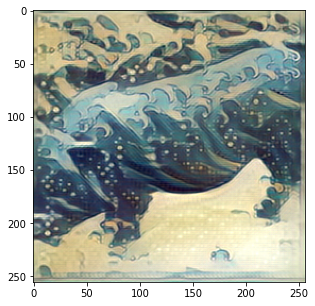

Saved sample stylized image at wave/images/sample0_19500.png
========Iteration 20001/25000========
	Content Loss:	523524.06
	Style Loss:	327422.51
	Total Loss:	850945.68
Time elapsed:	1500.8963503837585 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_20000.pth


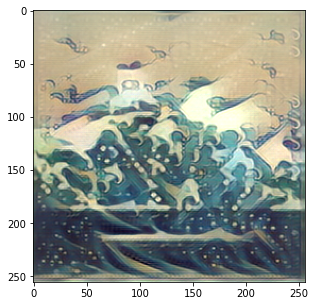

Saved sample stylized image at wave/images/sample0_20000.png
========Iteration 20501/25000========
	Content Loss:	522640.03
	Style Loss:	322493.16
	Total Loss:	845132.15
Time elapsed:	1538.4543290138245 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_20500.pth


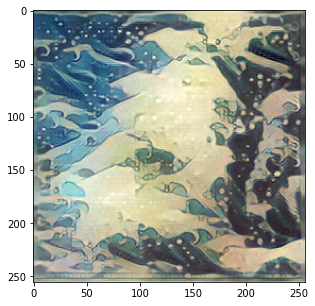

Saved sample stylized image at wave/images/sample0_20500.png
========Iteration 21001/25000========
	Content Loss:	521948.53
	Style Loss:	317786.36
	Total Loss:	839733.60
Time elapsed:	1575.893498659134 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_21000.pth


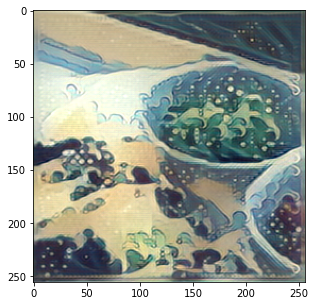

Saved sample stylized image at wave/images/sample0_21000.png
========Iteration 21501/25000========
	Content Loss:	521220.09
	Style Loss:	313250.90
	Total Loss:	834469.74
Time elapsed:	1613.3668785095215 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_21500.pth


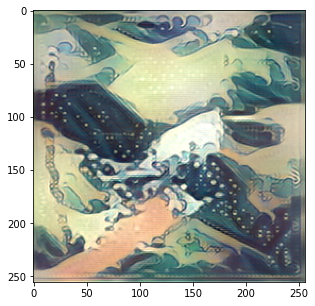

Saved sample stylized image at wave/images/sample0_21500.png
========Iteration 22001/25000========
	Content Loss:	520225.03
	Style Loss:	308947.54
	Total Loss:	829171.19
Time elapsed:	1650.8180718421936 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_22000.pth


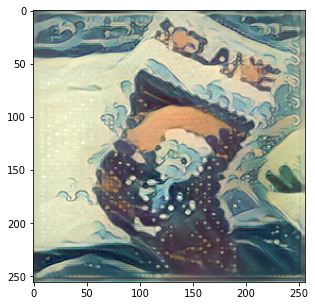

Saved sample stylized image at wave/images/sample0_22000.png
========Iteration 22501/25000========
	Content Loss:	519239.97
	Style Loss:	304830.68
	Total Loss:	824069.36
Time elapsed:	1688.220433473587 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_22500.pth


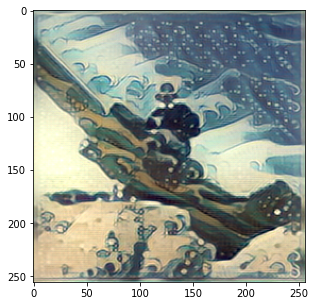

Saved sample stylized image at wave/images/sample0_22500.png
========Iteration 23001/25000========
	Content Loss:	518708.78
	Style Loss:	300855.55
	Total Loss:	819562.94
Time elapsed:	1725.6674962043762 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_23000.pth


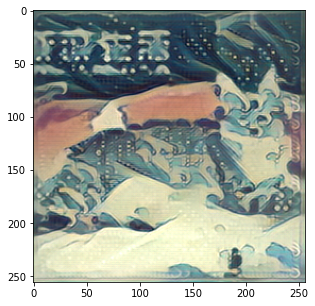

Saved sample stylized image at wave/images/sample0_23000.png
========Iteration 23501/25000========
	Content Loss:	517685.62
	Style Loss:	297030.15
	Total Loss:	814714.05
Time elapsed:	1763.1088590621948 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_23500.pth


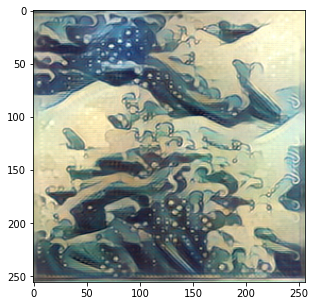

Saved sample stylized image at wave/images/sample0_23500.png
========Iteration 24001/25000========
	Content Loss:	516751.28
	Style Loss:	293362.23
	Total Loss:	810111.36
Time elapsed:	1800.529952764511 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_24000.pth


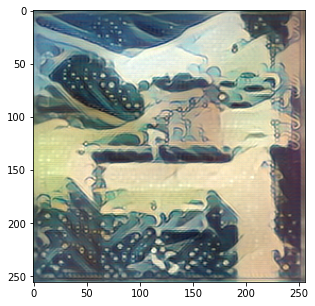

Saved sample stylized image at wave/images/sample0_24000.png
========Iteration 24501/25000========
	Content Loss:	516251.84
	Style Loss:	289884.93
	Total Loss:	806134.29
Time elapsed:	1837.9826021194458 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_24500.pth


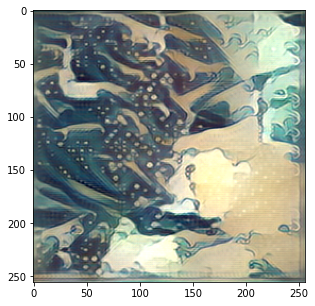

Saved sample stylized image at wave/images/sample0_24500.png
========Iteration 25000/25000========
	Content Loss:	515498.19
	Style Loss:	286509.15
	Total Loss:	802005.13
Time elapsed:	1875.3781180381775 seconds
Saved CustomModel checkpoint file at wave/models/checkpoint_24999.pth


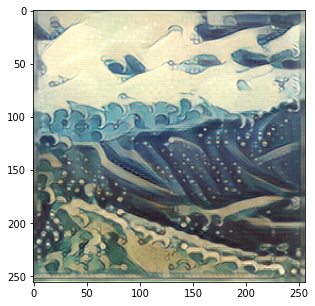

Saved sample stylized image at wave/images/sample0_24999.png
Done Training the Network!
Training Time: 1875.5940675735474 seconds
========Content Loss========
[39215760.0, 6544454.82734531, 3922352.8100024974, 2971481.504996669, 2468401.2071776614, 2150173.5112455017, 1930227.4064270244, 1768444.344633676, 1643920.2004030242, 1547174.875152744, 1465034.2331783643, 1396969.471925559, 1338995.3934708799, 1289828.2184231272, 1247405.4307107914, 1210105.9428701173, 1177183.728358174, 1147538.0154871487, 1120074.1075019443, 1095657.1266346963, 1073753.8623762624, 1053533.0318005427, 1034988.707694187, 1018101.5843812495, 1002043.7503411174, 987569.0084568234, 974521.7759066611, 961753.6215048885, 950025.2992821941, 939072.723277705, 928626.907589494, 918772.5438499935, 909521.0713978814, 900750.3128105872, 892685.8404744574, 884679.9998053683, 877558.0216151186, 870198.924816564, 863757.4006170728, 857051.8917619609, 850945.6820674591, 845132.148876884, 839733.5985429265, 834469.7376299358,

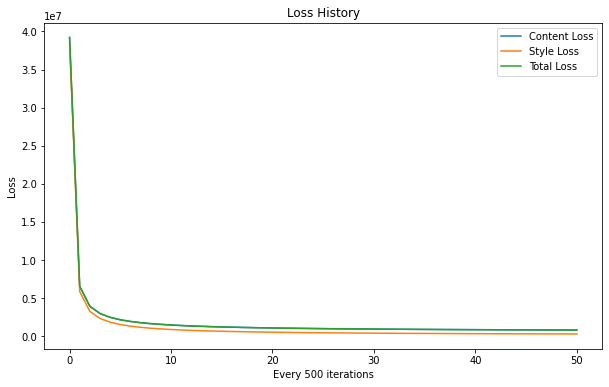

In [22]:
train()

In [23]:
# copy the models folder to the folder in the google drive
!cp -r wave/models/ /content/gdrive/My\ Drive/tinyimagenet_custom/wave/
# copy the images folder to the folder in the google drive
!cp -r wave/images/ /content/gdrive/My\ Drive/tinyimagenet_custom/wave/